<a href="https://colab.research.google.com/github/mooniewexx/DL/blob/main/dl_06_1_end_object_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#  Обнаружение объектов

__Автор задач: Блохин Н.В. (NVBlokhin@fa.ru)__

Материалы:
* https://pytorch.org/tutorials/intermediate/torchvision_tutorial.html
* https://pyimagesearch.com/2021/11/01/training-an-object-detector-from-scratch-in-pytorch/
* https://pyimagesearch.com/2021/08/02/pytorch-object-detection-with-pre-trained-networks/

## Задачи для совместного разбора

1. Рассмотрите простейшую архитектуру для решения задачи object detection и процесс настройки модели.

## Задачи для самостоятельного решения

<p class="task" id="1"></p>

### 1\. Напишите функцию `parse_xml`, которая читает xml-файл с разметкой изображения из архива `animals.zip` и возвращает словарь, содержащий три ключа:
```
{
        "raw": # словарь с ключами xmin, ymin, xmax, ymax
        "scaled": # словарь с ключами xmin, ymin, xmax, ymax
        "obj_name": # строка
}
```
В этом словаре `row` - абсолютные значения координат вершин bounding box, а `scaled` - относительные (нормированные на ширину и высоту изображения). Примените функцию к файлу `cat.0.xml` и выведите результат на экран.


- [ ] Проверено на семинаре

In [ ]:
import os
import zipfile
import xml.etree.ElementTree as ET

def parse_xml(file_path, zip_path):
    if not file_path.endswith(".xml"): # проверяем, что это XML файл
        raise ValueError(f"Неверный тип файла: {file_path}")

    with zipfile.ZipFile(zip_path, 'r') as archive:
        with archive.open(file_path) as file:
            tree = ET.parse(file)
            root = tree.getroot()

    size = root.find("size")
    width = int(size.find("width").text)
    height = int(size.find("height").text)

    obj = root.find("object")
    obj_name = obj.find("name").text

    bndbox = obj.find("bndbox")
    xmin = float(bndbox.find("xmin").text)
    ymin = float(bndbox.find("ymin").text)
    xmax = float(bndbox.find("xmax").text)
    ymax = float(bndbox.find("ymax").text)

    raw = {"xmin": xmin, "ymin": ymin, "xmax": xmax, "ymax": ymax}
    scaled = {
        "xmin": xmin / width,
        "ymin": ymin / height,
        "xmax": xmax / width,
        "ymax": ymax / height,
    }

    return {
        "raw": raw,
        "scaled": scaled,
        "obj_name": obj_name
    }

result = parse_xml('Asirra: cat vs dogs/'+"cat.0.xml", "animals.zip")
print(result)

{'raw': {'xmin': 126.0, 'ymin': 83.0, 'xmax': 354.0, 'ymax': 243.0}, 'scaled': {'xmin': 0.252, 'ymin': 0.22192513368983957, 'xmax': 0.708, 'ymax': 0.6497326203208557}, 'obj_name': 'cat'}


<p class="task" id="2"></p>

### 2\. Опишите датасет `AnimalDetectionDataset` на основе архива `animals.zip`. Реализуйте `__getitem__` таким образом, чтобы он возвращал три элемента: тензор с изображением, словарь с координатами bounding box и метку объекта. Предусмотрите возможность передавать извне при создании датасета набор преобразований для изображений, преобразование для метки объекта (для кодирования) и флаг, показывающий, нужно ли возвращать исходные или нормированные координаты bounding box.

- [ ] Проверено на семинаре

In [ ]:
from torch.utils.data import Dataset
from PIL import Image
import torchvision.transforms as T

class AnimalDetectionDataset(Dataset):
    def __init__(self, root, transforms=None, target_transform=None, return_scaled=True):
        self.root = root
        self.transforms = transforms
        self.target_transform = target_transform
        self.return_scaled = return_scaled

        with zipfile.ZipFile(root, 'r') as zip:
            self.xml_files = [f for f in zip.namelist() if f.endswith('.xml')]

    def __len__(self):
        return len(self.xml_files)

    def __getitem__(self, idx):
        xml_file = self.xml_files[idx]
        img_file = xml_file.replace(".xml", ".jpg")

        with zipfile.ZipFile(self.root, 'r') as zip:
            with zip.open(img_file) as file:
                img = Image.open(file).convert("RGB")

        data = parse_xml(xml_file, self.root)
        box = data["scaled"] if self.return_scaled else data["raw"]
        label = data["obj_name"]

        if self.transforms:
            img = self.transforms(img)
        if self.target_transform:
            label = self.target_transform(label)

        return img, box, label

<p class="task" id="3"></p>

### 3\. Создайте объект класса `AnimalDetectionDataset` без применения преобразований и со значением `return_scaled=False`. Напишите функцию `show_image_with_bounding_box` для визуализации изображения с добавлением на него bounding box и подписи объекта. Продемонстрируйте работу функцию на изображении собаки и кошки.

- [ ] Проверено на семинаре

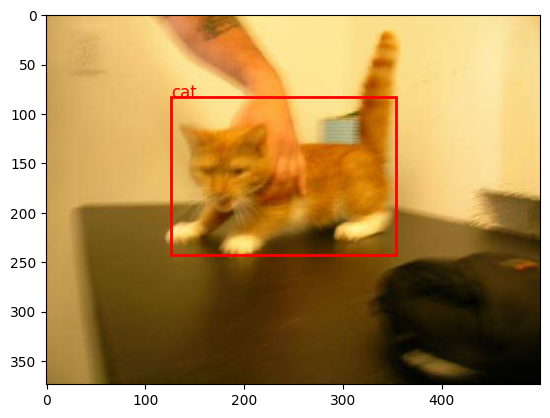

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import torch

def show_image_with_bounding_box(image, box, label):
    if not isinstance(image, torch.Tensor): # если изображение не тензор, преобразуем его
        transform = T.ToTensor()
        image = transform(image)

    fig, ax = plt.subplots(1)
    ax.imshow(image.permute(1, 2, 0))  # tensor (C, H, W) to image format (H, W, C)

    rect = patches.Rectangle(
        (box["xmin"], box["ymin"]), # левый верхний угол коорд
        box["xmax"] - box["xmin"], # ширина
        box["ymax"] - box["ymin"], # высота
        linewidth=2,
        edgecolor="red",
        facecolor="none"
    )
    ax.add_patch(rect)
    plt.text(box["xmin"], box["ymin"], label, color="red", fontsize=12)
    plt.show()

# Пример работы
dataset = AnimalDetectionDataset("animals.zip", return_scaled=False)
img, box, label = dataset[0]
show_image_with_bounding_box(img, box, label)

In [ ]:
!unzip -l my_animals_all.zip | grep cat.0.xml

      494  2024-11-22 00:29   my_animals_all/cat.0.xml


In [ ]:
dataset = AnimalDetectionDataset("my_animals_2.zip", return_scaled=False)
img, box, label = dataset[0]
show_image_with_bounding_box(img, box, label)

FileNotFoundError: [Errno 2] No such file or directory: 'my_animals_2.zip'

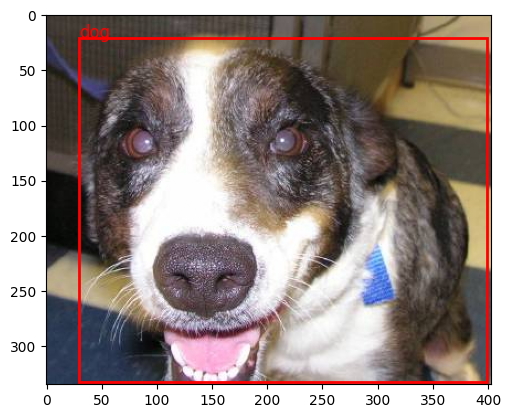

In [ ]:
img, box, label = dataset[1000]
show_image_with_bounding_box(img, box, label)

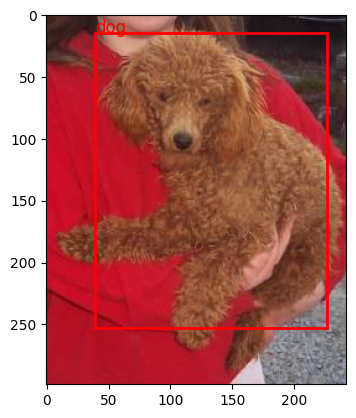

In [ ]:
img, box, label = dataset[1001]
show_image_with_bounding_box(img, box, label)

In [ ]:
dataset[0]

(<PIL.Image.Image image mode=RGB size=500x374>,
 {'xmin': 126.0, 'ymin': 83.0, 'xmax': 354.0, 'ymax': 243.0},
 'cat')

In [ ]:
dataset[1001]

(<PIL.Image.Image image mode=RGB size=243x299>,
 {'xmin': 39.0, 'ymin': 14.0, 'xmax': 227.0, 'ymax': 253.0},
 'dog')

### Обучение 2.0:

<p class="task" id="4"></p>
4. Напишите модель для решения задачи выделения объектов. Реализуйте двухголовую сеть, одна голова которой предсказывает метку объекта (задача классификации), а вторая голова предсказывает 4 координаты вершин bounding box (задача регрессии). В качестве backbone используйте модель resnet50 из пакета `torchvision`.

- [ ] Проверено на семинаре

In [ ]:
'''старое:
class ObjectDetectionModel_N(nn.Module):
    def __init__(self, num_classes):
        super(ObjectDetectionModel_N, self).__init__()
        backbone = resnet50(pretrained=True, weights='IMAGENET1K_V1')  # для torch >= 0.13.0
        self.backbone = nn.Sequential(*list(backbone.children())[:-2])  # убираем последний слой классификации
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))  # pooling для уменьшения размерности
        self.freeze_backbone()  # заморозка backbone для ускорения обучения

        self.fc_class = nn.Linear(2048, num_classes)  # классификация (кол-во классов)
        self.fc_bbox = nn.Linear(2048, 4)  # регрессия (координаты bbox)

    def freeze_backbone(self): # заморозка слоев backbone для ускорения обучения
        for param in self.backbone.parameters():
            param.requires_grad = False

    def forward(self, x):
        x = self.backbone(x)
        x = self.avgpool(x)
        x = torch.flatten(x, 1)  # преобразование к [batch_size, features]

        # две головы
        class_output = self.fc_class(x)  # предсказания класса
        bbox_output = self.fc_bbox(x)  # координаты bbox
        return class_output, bbox_output

In [ ]:
import torch
import torch.nn as nn
from torchvision.models import resnet50

class ObjectDetectionModel(nn.Module):
    def __init__(self, num_classes):
        super(ObjectDetectionModel, self).__init__()
        backbone = resnet50(pretrained=True, weights='IMAGENET1K_V1')
        self.backbone = nn.Sequential(*list(backbone.children())[:-2])  # удаляем последний слой классификации(линейный FC слой и avg pool)
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))  # уменьшение размерности до (1, 1)

        self.freeze_backbone()  # заморозка слоев backbone для ускорения обучения

        # голова для классификации (выход: num_classes)
        self.fc_class = nn.Sequential(
            nn.Linear(2048, 512),
            nn.ReLU(),
            nn.Dropout(0.3),  # Dropout для борьбы с переобучением
            nn.Linear(512, num_classes),
            nn.Softmax(dim=1)  # Softmax для вероятностей классов
        )

        # голова для регрессии координат (выход: 4) # x_min, y_min, x_max, y_max
        self.fc_bbox = nn.Sequential(
            nn.Linear(2048, 512),
            nn.ReLU(),
            nn.Dropout(0.3),  # Dropout для улучшения обобщающей способности
            nn.Linear(512, 4)
        )

    def freeze_backbone(self): #  заморозка всех параметров backbone для ускорения обучения
        for param in self.backbone.parameters():
            param.requires_grad = False

    def forward(self, x):
        # извлечение признаков с помощью backbone
        x = self.backbone(x)
        x = self.avgpool(x)
        x = torch.flatten(x, 1)  # преобразуем в вектор [batch_size, features]

        # прогон через две головы
        class_output = self.fc_class(x)  # предсказание класса
        bbox_output = self.fc_bbox(x)  # предсказание координат bbox

        return class_output, bbox_output


In [ ]:
class ObjectDetectionModel_sc(nn.Module):
    def __init__(self, num_classes):
        super(ObjectDetectionModel_sc, self).__init__()
        backbone = resnet50(pretrained=True)
        self.backbone = nn.Sequential(*list(backbone.children())[:-2])  # убираем последний слой классификации
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))  # уменьшаем размерность до (1, 1)

        self.freeze_backbone()

        # для классификации (выход: num_classes)
        self.fc_class = nn.Sequential(
            nn.Linear(2048 + 2048, 512),  # увеличиваем входные признаки для skip connection
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(512, num_classes),
            nn.Softmax(dim=1)
        )

        # для регрессии координат (выход: 4)
        self.fc_bbox = nn.Sequential(
            nn.Linear(2048 + 2048, 512),  # увеличиваем входные признаки для skip connection
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(512, 4)
        )

    def freeze_backbone(self):
        for param in self.backbone.parameters():
            param.requires_grad = False

    def forward(self, x):
        features = self.backbone(x)
        pooled_features = self.avgpool(features)
        pooled_features = torch.flatten(pooled_features, 1)  # преобразуем в вектор [batch_size, features]

        # добавляем skip connection: соединяем признаки до и после пулинга
        skip_connection = torch.flatten(features, 1)  # преобразуем оригинальные признаки в вектор
        combined_features = torch.cat([pooled_features, skip_connection], dim=1)  # пбъединяем вдоль оси признаков

        # прогон через две головы
        class_output = self.fc_class(combined_features)  # предсказание класса
        bbox_output = self.fc_bbox(combined_features)  # предсказание координат bbox

        return class_output, bbox_output


<p class="task" id="5"></p>

5\. Разбейте набор данных на обучающее и валидационное множество. Обучите модель, описанную в задаче 4. При создании датасета не забудьте указать преобразования, соответствующие модели ResNet.

Используйте сумму MSELoss (для расчета ошибки на задаче регрессии) и CrossEntropyLoss (для расчета ошибки на задачи классификации) для настройки весов модели. Для ускорения процесса обучения слои backbone можно заморозить. Во время обучения выводите на экран значения функции потерь на обучающем и валидационном множестве. Используя обученную модель, получите предсказания для изображения кошки и собаки и отрисуйте их. Выполните процедуру, обратную нормализации, чтобы корректно отобразить фотографии.

- [ ] Проверено на семинаре

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, random_split
import torchvision.transforms as T
from torchvision.models import resnet50
import matplotlib.pyplot as plt

transforms = T.Compose([
    T.Resize((224, 224)),  # размер для ResNet
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # нормализация для ResNet
])

dataset = AnimalDetectionDataset("animals.zip", transforms=transforms)

train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8)

In [ ]:
model = ObjectDetectionModel(num_classes=2).to("cuda")

optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4)
criterion_class = nn.CrossEntropyLoss()
criterion_bbox = nn.MSELoss()

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []

label_mapping = {'cat': 0, 'dog': 1}

for epoch in range(10):
    model.train()
    train_loss, correct_train, total_train = 0.0, 0, 0

    for imgs, boxes, labels in train_loader:
        imgs = imgs.to("cuda")
        boxes_tensor = torch.stack(
            [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
            dim=1
        ).to("cuda").float()
        labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

        preds_class, preds_bbox = model(imgs)
        loss_class = criterion_class(preds_class, labels_tensor)
        loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
        loss = loss_class + loss_bbox

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        _, predicted = torch.max(preds_class, 1)
        total_train += labels_tensor.size(0)
        correct_train += (predicted == labels_tensor).sum().item()

    train_losses.append(train_loss / len(train_loader))
    train_accuracies.append(correct_train / total_train * 100)

    model.eval()
    val_loss, correct_val, total_val = 0.0, 0, 0
    with torch.no_grad():
        for imgs, boxes, labels in val_loader:
            imgs = imgs.to("cuda")
            boxes_tensor = torch.stack(
                [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
                dim=1
            ).to("cuda").float()
            labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

            preds_class, preds_bbox = model(imgs)
            loss_class = criterion_class(preds_class, labels_tensor)
            loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
            val_loss += loss_class.item() + loss_bbox.item()

            _, predicted = torch.max(preds_class, 1)
            total_val += labels_tensor.size(0)
            correct_val += (predicted == labels_tensor).sum().item()

    val_losses.append(val_loss / len(val_loader))
    val_accuracies.append(correct_val / total_val * 100)

    print(f"Epoch {epoch+1}: Train Loss: {train_losses[-1]:.4f}, Train Accuracy: {train_accuracies[-1]:.2f}%, "
          f"Val Loss: {val_losses[-1]:.4f}, Val Accuracy: {val_accuracies[-1]:.2f}%")

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 110MB/s]


Epoch 1: Train Loss: 0.5324, Train Accuracy: 86.59%, Val Loss: 0.3860, Val Accuracy: 97.73%
Epoch 2: Train Loss: 0.4202, Train Accuracy: 92.50%, Val Loss: 0.3589, Val Accuracy: 98.64%
Epoch 3: Train Loss: 0.4104, Train Accuracy: 92.27%, Val Loss: 0.3511, Val Accuracy: 98.64%
Epoch 4: Train Loss: 0.3980, Train Accuracy: 93.18%, Val Loss: 0.3679, Val Accuracy: 97.27%
Epoch 5: Train Loss: 0.3946, Train Accuracy: 94.09%, Val Loss: 0.3469, Val Accuracy: 98.64%
Epoch 6: Train Loss: 0.3961, Train Accuracy: 93.07%, Val Loss: 0.3475, Val Accuracy: 97.73%
Epoch 7: Train Loss: 0.4003, Train Accuracy: 92.95%, Val Loss: 0.3796, Val Accuracy: 93.64%
Epoch 8: Train Loss: 0.3857, Train Accuracy: 94.32%, Val Loss: 0.3531, Val Accuracy: 96.82%
Epoch 9: Train Loss: 0.3822, Train Accuracy: 94.55%, Val Loss: 0.3424, Val Accuracy: 98.18%
Epoch 10: Train Loss: 0.3732, Train Accuracy: 96.02%, Val Loss: 0.3416, Val Accuracy: 98.64%


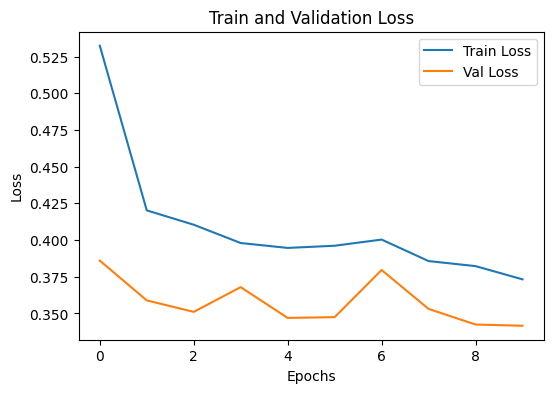

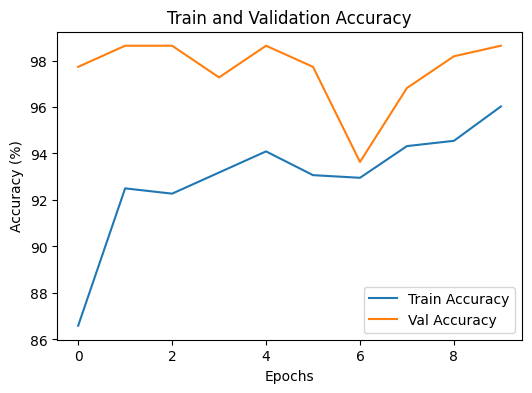

In [ ]:
plt.figure(figsize=(6, 4))
plt.plot(train_losses, label="Train Loss")
plt.plot(val_losses, label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Train and Validation Loss")
plt.legend()
plt.show()

plt.figure(figsize=(6, 4))
plt.plot(train_accuracies, label="Train Accuracy")
plt.plot(val_accuracies, label="Val Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.title("Train and Validation Accuracy")
plt.legend()
plt.show()

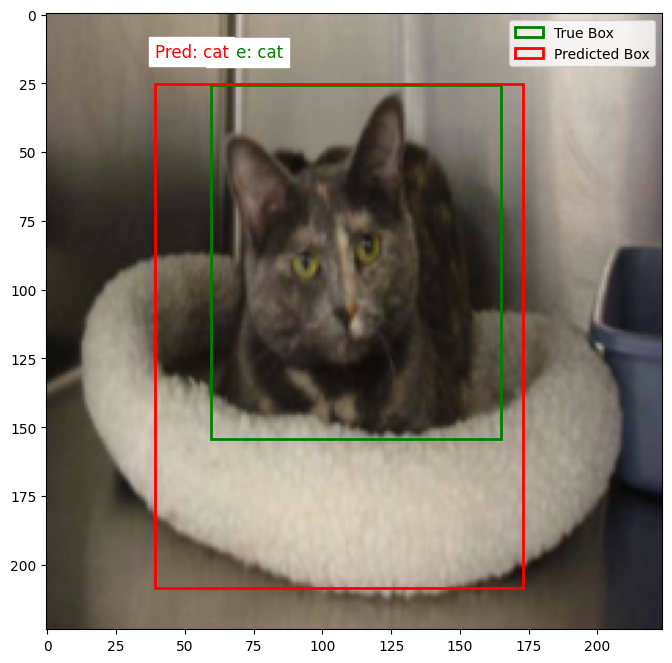

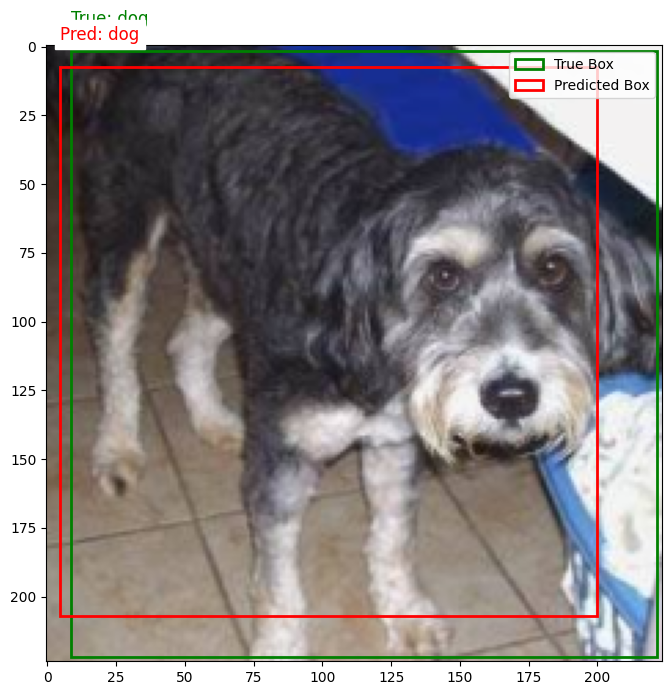

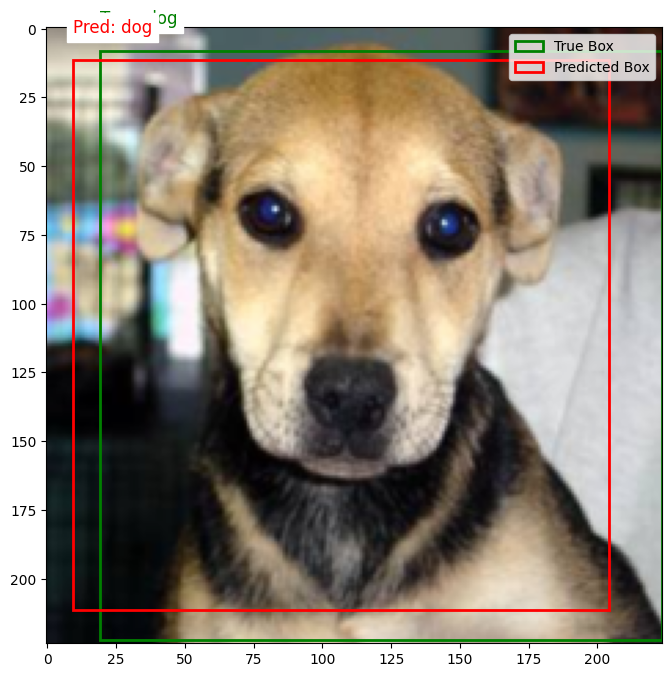

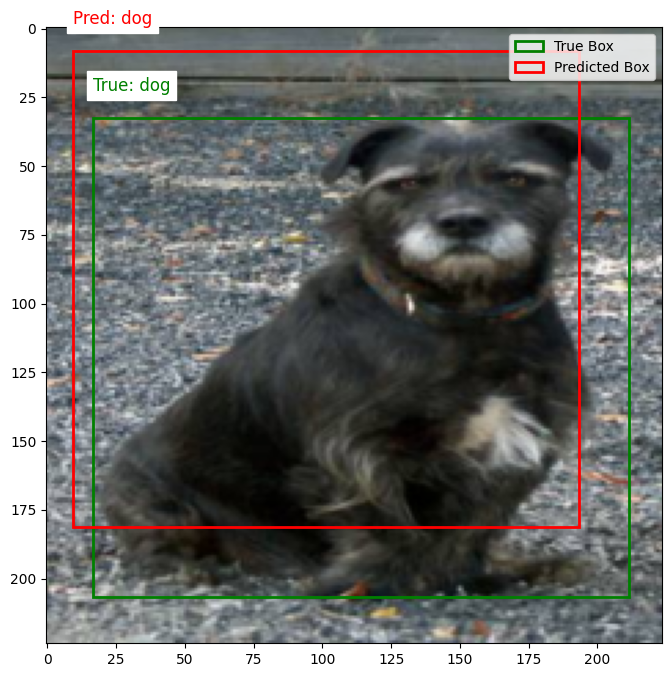

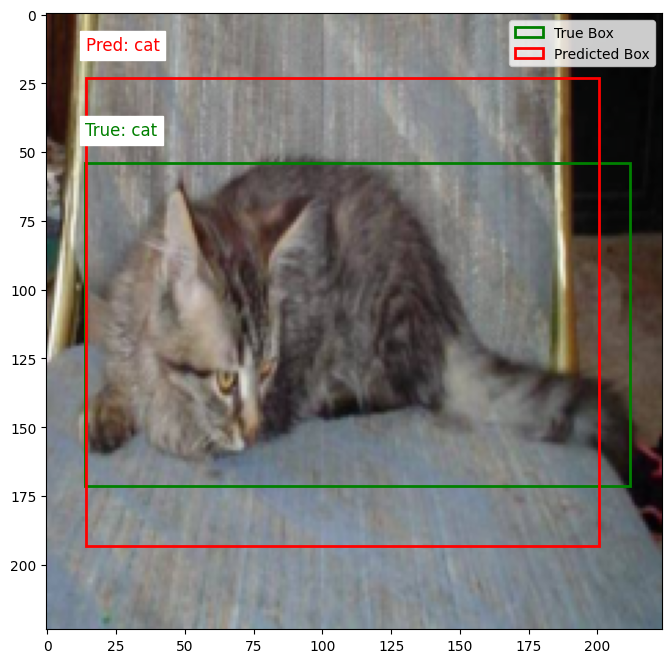

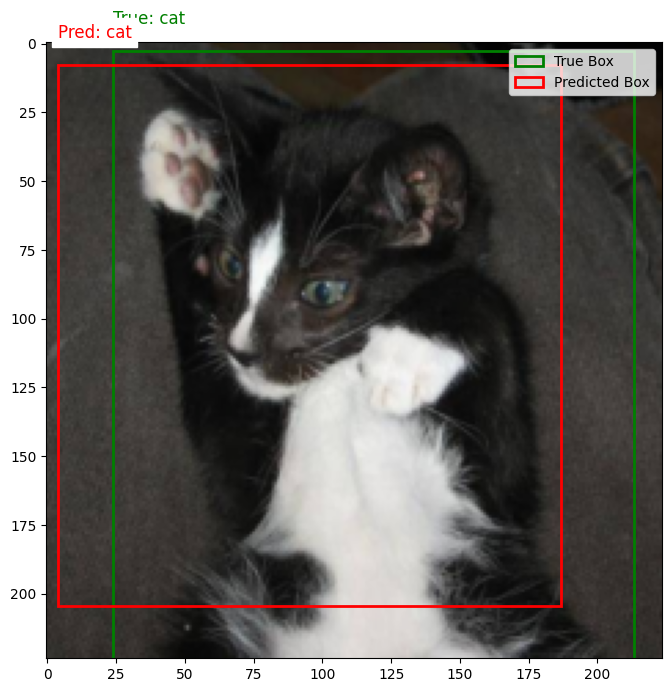

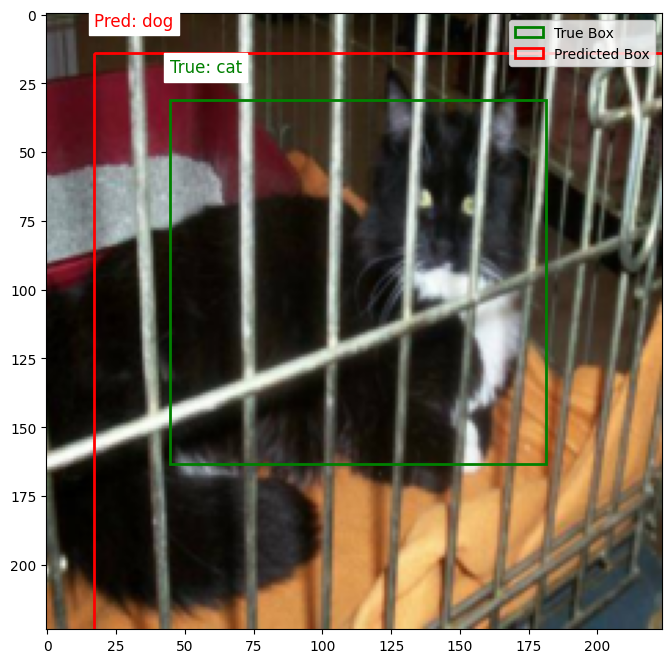

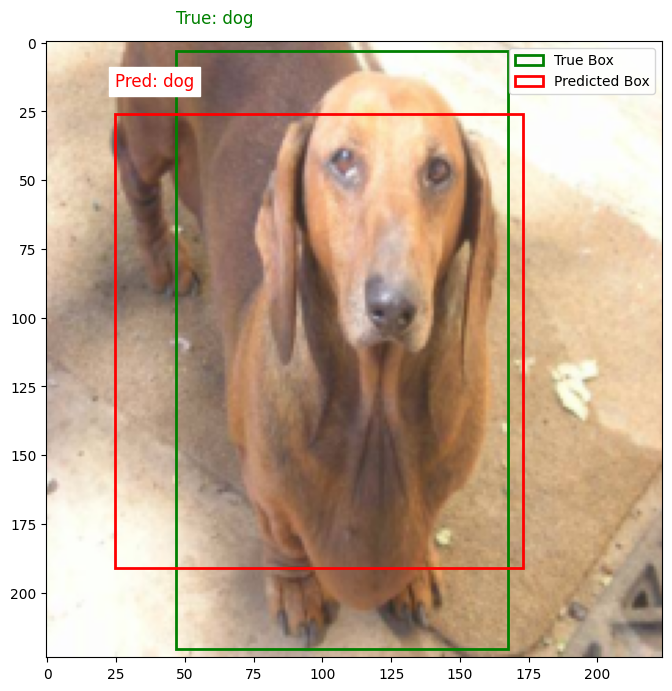

In [ ]:
import matplotlib.patches as patches

def show_image_with_bounding_box(image, true_box, pred_box, true_label, pred_label):
    if isinstance(image, torch.Tensor):  # преобразование тензора в numpy, если необходимо
        image = image.permute(1, 2, 0).numpy()
        image = image * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]  # обратная нормализация
        image = image.clip(0, 1)

    fig, ax = plt.subplots(1, figsize=(8, 8))
    ax.imshow(image)

    # истинный bounding box
    if true_box:
        ax.add_patch(patches.Rectangle(
            (true_box[0], true_box[1]), # верхний левый угол
            true_box[2] - true_box[0], # ширина
            true_box[3] - true_box[1], # высота
            linewidth=2, edgecolor="green", facecolor="none", label="True Box"
        ))
        plt.text(
            true_box[0], true_box[1] - 10, f"True: {true_label}",
            color="green", fontsize=12, backgroundcolor="white"
        )

    # предсказанный bounding box
    if pred_box:
        ax.add_patch(patches.Rectangle(
            (pred_box[0], pred_box[1]),
            pred_box[2] - pred_box[0],
            pred_box[3] - pred_box[1],
            linewidth=2, edgecolor="red", facecolor="none", label="Predicted Box"
        ))
        plt.text(
            pred_box[0], pred_box[1] - 10, f"Pred: {pred_label}",
            color="red", fontsize=12, backgroundcolor="white"
        )

    plt.legend(loc="upper right")
    plt.show()

# валидация модели с визуализацией
model.eval()
with torch.no_grad():
    for imgs, boxes, labels in val_loader:
        imgs = imgs.to("cuda")
        preds_class, preds_bbox = model(imgs)

        for i in range(len(imgs)):
            # извлечение изображения
            img = imgs[i].cpu()

            # истинные значения bounding box и метка
            true_box = [
                boxes["xmin"][i].item() * img.shape[2],
                boxes["ymin"][i].item() * img.shape[1],
                boxes["xmax"][i].item() * img.shape[2],
                boxes["ymax"][i].item() * img.shape[1]
            ]
            true_label = labels[i]  # истинная метка класса

            # предсказания: bounding box и метка
            pred_box = [
                preds_bbox[i][0].item() * img.shape[2],
                preds_bbox[i][1].item() * img.shape[1],
                preds_bbox[i][2].item() * img.shape[2],
                preds_bbox[i][3].item() * img.shape[1]
            ]
            pred_label = list(label_mapping.keys())[torch.argmax(preds_class[i]).item()]  # предсказанный класс

            # визуализация
            show_image_with_bounding_box(
                img,
                true_box=true_box,
                pred_box=pred_box,
                true_label=true_label,
                pred_label=pred_label
            )
        break


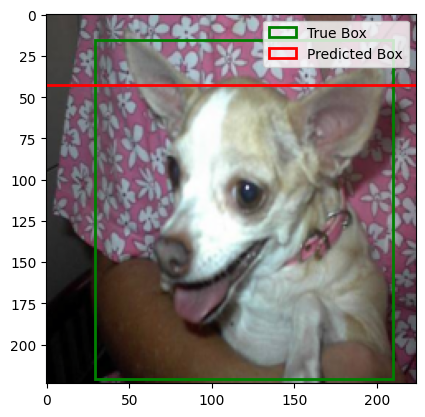

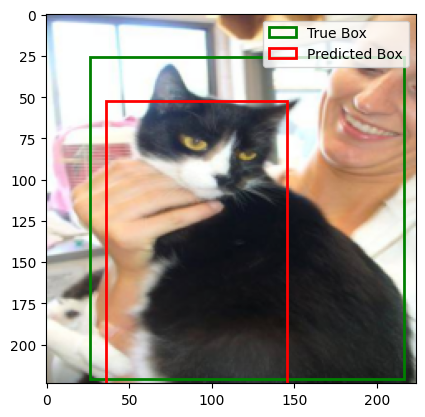

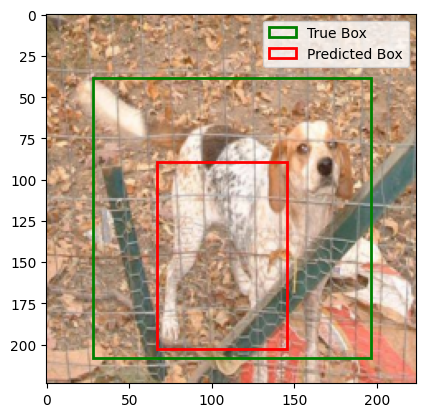

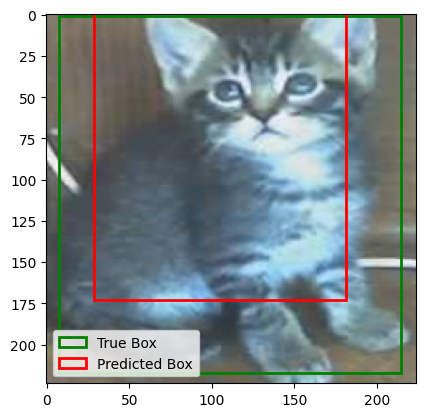

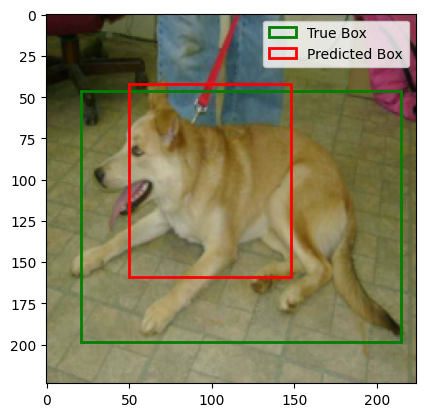

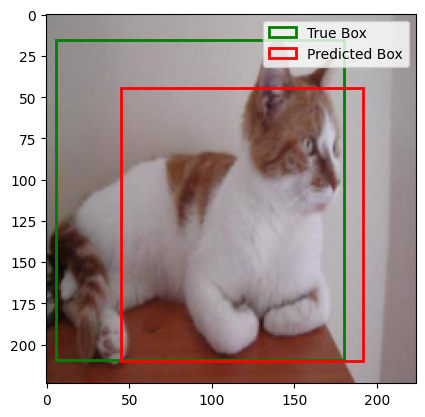

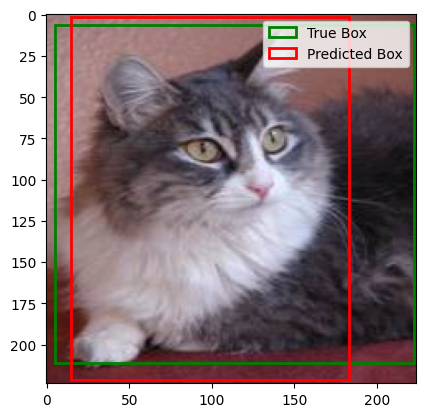

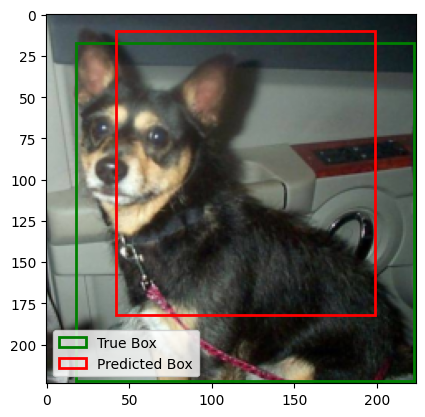

In [ ]:
model.eval()
with torch.no_grad():
    for imgs, boxes, labels in val_loader:
        imgs = imgs.to("cuda")
        preds_class, preds_bbox = model(imgs)

        for i in range(len(imgs)):
            # Извлечение изображения
            img = imgs[i].cpu().permute(1, 2, 0).numpy()
            img = img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]  # Обратная нормализация
            img = img.clip(0, 1)

            # Извлечение размеров изображения
            img_height, img_width = img.shape[:2]

            # Преобразование true_box
            true_box = [
                boxes["xmin"][i].item() * img_width,
                boxes["ymin"][i].item() * img_height,
                boxes["xmax"][i].item() * img_width,
                boxes["ymax"][i].item() * img_height
            ]

            # Преобразование pred_box
            pred_box = [
                preds_bbox[i][0].item() * img_width,
                preds_bbox[i][1].item() * img_height,
                preds_bbox[i][2].item() * img_width,
                preds_bbox[i][3].item() * img_height
            ]

            # Отрисовка
            plt.imshow(img)
            plt.gca().add_patch(plt.Rectangle(
                (true_box[0], true_box[1]),
                true_box[2] - true_box[0],
                true_box[3] - true_box[1],
                edgecolor="green", fill=False, linewidth=2, label="True Box"
            ))
            plt.gca().add_patch(plt.Rectangle(
                (pred_box[0], pred_box[1]),
                pred_box[2] - pred_box[0],
                pred_box[3] - pred_box[1],
                edgecolor="red", fill=False, linewidth=2, label="Predicted Box"
            ))
            plt.legend()
            plt.show()
        break

### Обучение с skip connection:

<p class="task" id="4"></p>
4. Напишите модель для решения задачи выделения объектов. Реализуйте двухголовую сеть, одна голова которой предсказывает метку объекта (задача классификации), а вторая голова предсказывает 4 координаты вершин bounding box (задача регрессии). В качестве backbone используйте модель resnet50 из пакета `torchvision`.

- [ ] Проверено на семинаре

In [ ]:
import torch
import torch.nn as nn
from torchvision.models import resnet50

class ObjectDetectionModel_sc(nn.Module):
    def __init__(self, num_classes):
        super(ObjectDetectionModel_sc, self).__init__()
        backbone = resnet50(pretrained=True)
        self.backbone = nn.Sequential(*list(backbone.children())[:-2])  # убираем последний слой классификации
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))  # уменьшаем размерность до (1, 1)

        self.freeze_backbone()

        # для классификации (выход: num_classes)
        self.fc_class = nn.Sequential(
            nn.Linear(2048 + 2048, 512),  # увеличиваем входные признаки для skip connection
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(512, num_classes),
            nn.Softmax(dim=1)
        )

        # для регрессии координат (выход: 4)
        self.fc_bbox = nn.Sequential(
            nn.Linear(2048 + 2048, 512),  # увеличиваем входные признаки для skip connection
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(512, 4)
        )

    def freeze_backbone(self):
        for param in self.backbone.parameters():
            param.requires_grad = False

    def forward(self, x):
        features = self.backbone(x)  # [batch_size, 2048, H, W]
        pooled_features = self.avgpool(features)  # [batch_size, 2048, 1, 1]
        pooled_features = torch.flatten(pooled_features, 1)  # [batch_size, 2048]

        # добавляем skip connection: уменьшаем размерности перед объединением
        reduced_features = self.avgpool(features)  # снова адаптивный пулинг
        skip_connection = torch.flatten(reduced_features, 1)  # [batch_size, 2048]

        # объединяем признаки вдоль оси признаков
        combined_features = torch.cat([pooled_features, skip_connection], dim=1)  # [batch_size, 2048 + 2048]

        # прогон через две головы
        class_output = self.fc_class(combined_features)  # предсказание класса
        bbox_output = self.fc_bbox(combined_features)  # предсказание координат bbox

        return class_output, bbox_output
'''
    def forward(self, x):
        features = self.backbone(x)
        pooled_features = self.avgpool(features)
        pooled_features = torch.flatten(pooled_features, 1)  # преобразуем в вектор [batch_size, features]

        # добавляем skip connection: соединяем признаки до и после пулинга
        skip_connection = torch.flatten(features, 1)  # преобразуем оригинальные признаки в вектор
        combined_features = torch.cat([pooled_features, skip_connection], dim=1)  # пбъединяем вдоль оси признаков

        # прогон через две головы
        class_output = self.fc_class(combined_features)  # предсказание класса
        bbox_output = self.fc_bbox(combined_features)  # предсказание координат bbox

        return class_output, bbox_output
'''


'\n    def forward(self, x):\n        # Извлечение признаков с помощью backbone\n        features = self.backbone(x)\n        pooled_features = self.avgpool(features)\n        pooled_features = torch.flatten(pooled_features, 1)  # Преобразуем в вектор [batch_size, features]\n\n        # Добавляем skip connection: соединяем признаки до и после пулинга\n        skip_connection = torch.flatten(features, 1)  # Преобразуем оригинальные признаки в вектор\n        combined_features = torch.cat([pooled_features, skip_connection], dim=1)  # Объединяем вдоль оси признаков\n\n        # Прогон через две головы\n        class_output = self.fc_class(combined_features)  # Предсказание класса\n        bbox_output = self.fc_bbox(combined_features)  # Предсказание координат bbox\n\n        return class_output, bbox_output\n'

<p class="task" id="5"></p>

5\. Разбейте набор данных на обучающее и валидационное множество. Обучите модель, описанную в задаче 4. При создании датасета не забудьте указать преобразования, соответствующие модели ResNet.

Используйте сумму MSELoss (для расчета ошибки на задаче регрессии) и CrossEntropyLoss (для расчета ошибки на задачи классификации) для настройки весов модели. Для ускорения процесса обучения слои backbone можно заморозить. Во время обучения выводите на экран значения функции потерь на обучающем и валидационном множестве. Используя обученную модель, получите предсказания для изображения кошки и собаки и отрисуйте их. Выполните процедуру, обратную нормализации, чтобы корректно отобразить фотографии.

- [ ] Проверено на семинаре

In [ ]:
model = ObjectDetectionModel_sc(num_classes=2).to("cuda")

optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4)
criterion_class = nn.CrossEntropyLoss()
criterion_bbox = nn.MSELoss()

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []

label_mapping = {'cat': 0, 'dog': 1}

for epoch in range(10):
    model.train()
    train_loss, correct_train, total_train = 0.0, 0, 0

    for imgs, boxes, labels in train_loader:
        imgs = imgs.to("cuda")
        boxes_tensor = torch.stack(
            [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
            dim=1
        ).to("cuda").float()
        labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

        preds_class, preds_bbox = model(imgs)
        loss_class = criterion_class(preds_class, labels_tensor)
        loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
        loss = loss_class + loss_bbox

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        _, predicted = torch.max(preds_class, 1)
        total_train += labels_tensor.size(0)
        correct_train += (predicted == labels_tensor).sum().item()

    train_losses.append(train_loss / len(train_loader))
    train_accuracies.append(correct_train / total_train * 100)

    model.eval()
    val_loss, correct_val, total_val = 0.0, 0, 0
    with torch.no_grad():
        for imgs, boxes, labels in val_loader:
            imgs = imgs.to("cuda")
            boxes_tensor = torch.stack(
                [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
                dim=1
            ).to("cuda").float()
            labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

            preds_class, preds_bbox = model(imgs)
            loss_class = criterion_class(preds_class, labels_tensor)
            loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
            val_loss += loss_class.item() + loss_bbox.item()

            _, predicted = torch.max(preds_class, 1)
            total_val += labels_tensor.size(0)
            correct_val += (predicted == labels_tensor).sum().item()

    val_losses.append(val_loss / len(val_loader))
    val_accuracies.append(correct_val / total_val * 100)

    print(f"Epoch {epoch+1}: Train Loss: {train_losses[-1]:.4f}, Train Accuracy: {train_accuracies[-1]:.2f}%, "
          f"Val Loss: {val_losses[-1]:.4f}, Val Accuracy: {val_accuracies[-1]:.2f}%")

Epoch 1: Train Loss: 0.4810, Train Accuracy: 88.64%, Val Loss: 0.3921, Val Accuracy: 94.09%
Epoch 2: Train Loss: 0.4104, Train Accuracy: 92.84%, Val Loss: 0.3695, Val Accuracy: 96.82%
Epoch 3: Train Loss: 0.4068, Train Accuracy: 93.41%, Val Loss: 0.3740, Val Accuracy: 96.36%
Epoch 4: Train Loss: 0.4006, Train Accuracy: 93.86%, Val Loss: 0.3605, Val Accuracy: 96.36%
Epoch 5: Train Loss: 0.4046, Train Accuracy: 92.27%, Val Loss: 0.3654, Val Accuracy: 96.36%
Epoch 6: Train Loss: 0.4017, Train Accuracy: 91.59%, Val Loss: 0.3682, Val Accuracy: 95.91%
Epoch 7: Train Loss: 0.3929, Train Accuracy: 93.30%, Val Loss: 0.3605, Val Accuracy: 95.91%
Epoch 8: Train Loss: 0.3979, Train Accuracy: 93.07%, Val Loss: 0.3631, Val Accuracy: 96.36%
Epoch 9: Train Loss: 0.3944, Train Accuracy: 93.30%, Val Loss: 0.3694, Val Accuracy: 95.00%
Epoch 10: Train Loss: 0.3839, Train Accuracy: 94.20%, Val Loss: 0.3640, Val Accuracy: 95.91%


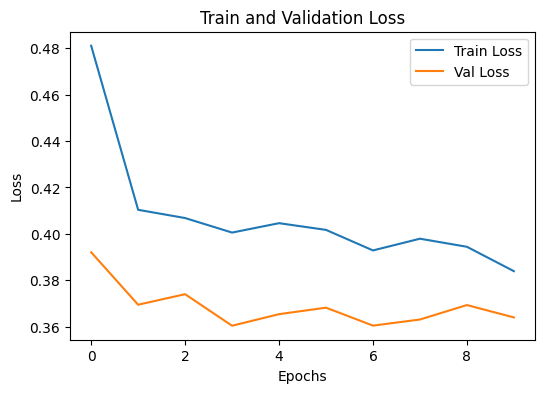

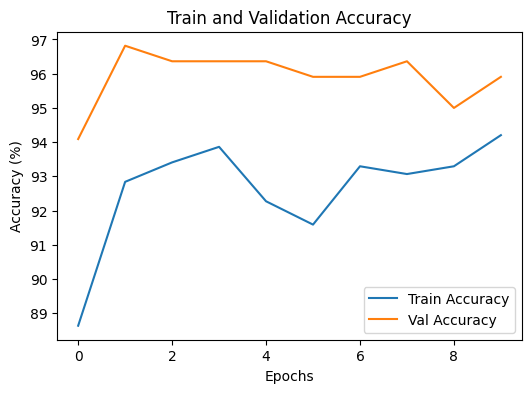

In [ ]:
plt.figure(figsize=(6, 4))
plt.plot(train_losses, label="Train Loss")
plt.plot(val_losses, label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Train and Validation Loss")
plt.legend()
plt.show()

plt.figure(figsize=(6, 4))
plt.plot(train_accuracies, label="Train Accuracy")
plt.plot(val_accuracies, label="Val Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.title("Train and Validation Accuracy")
plt.legend()
plt.show()

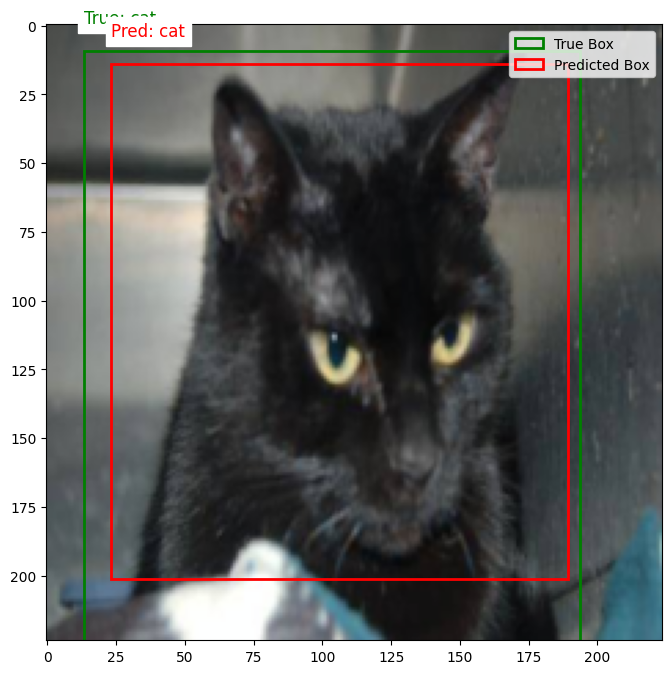

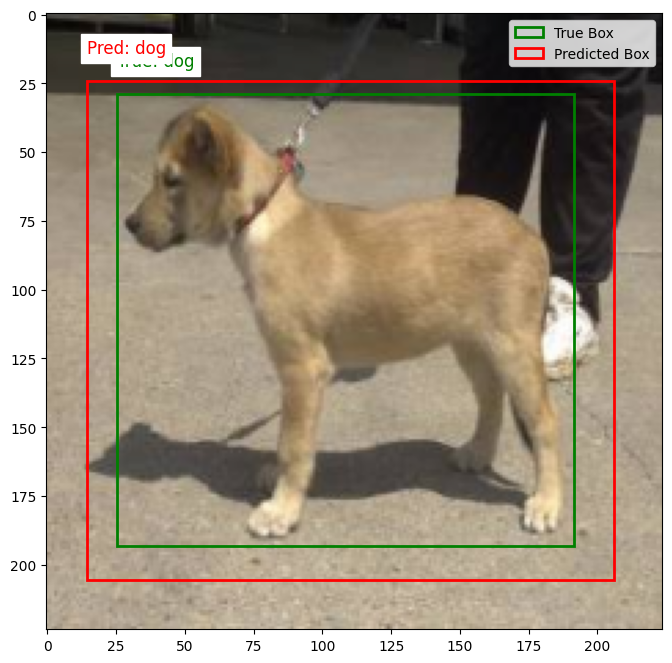

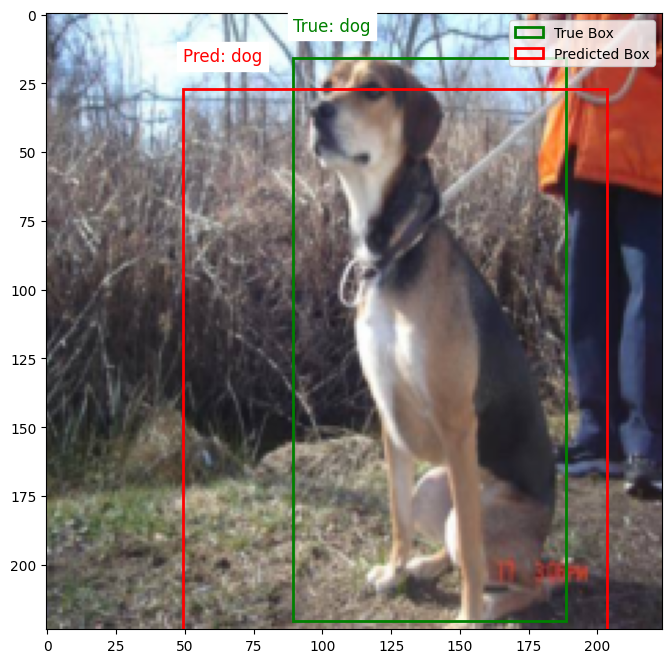

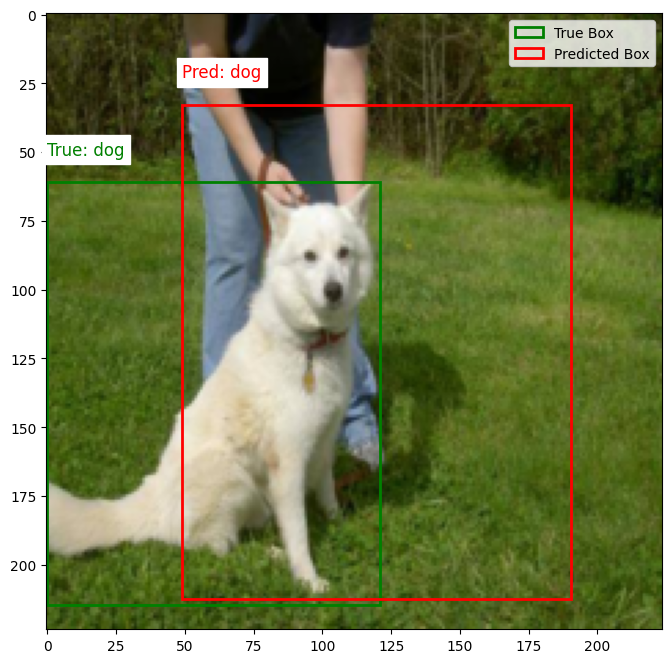

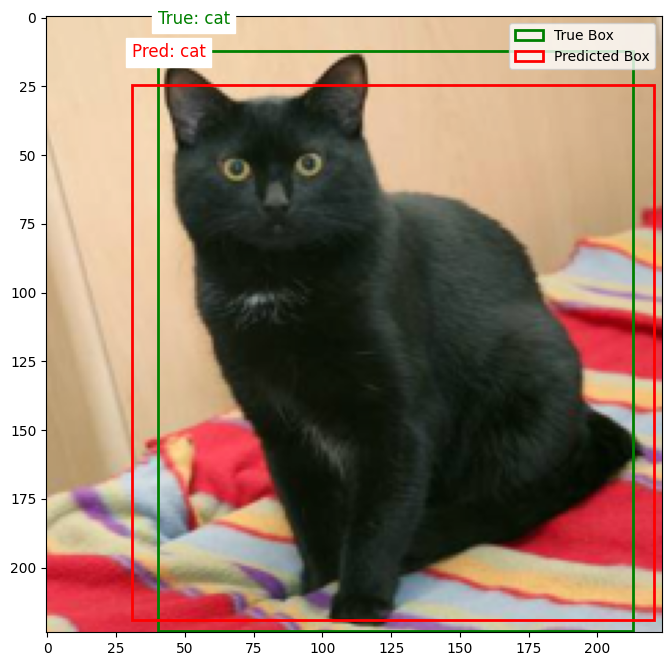

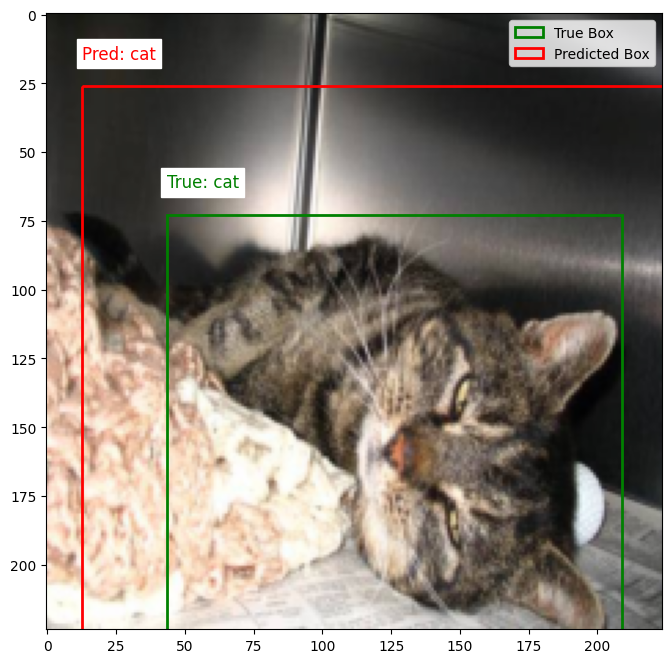

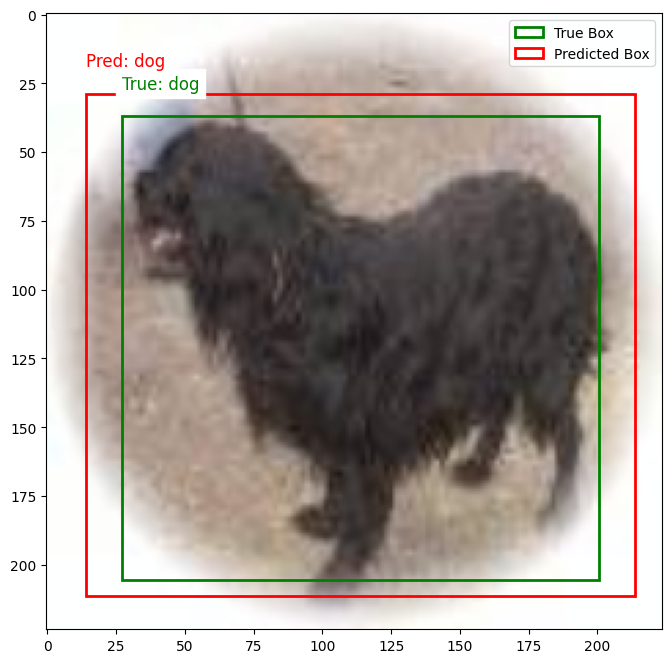

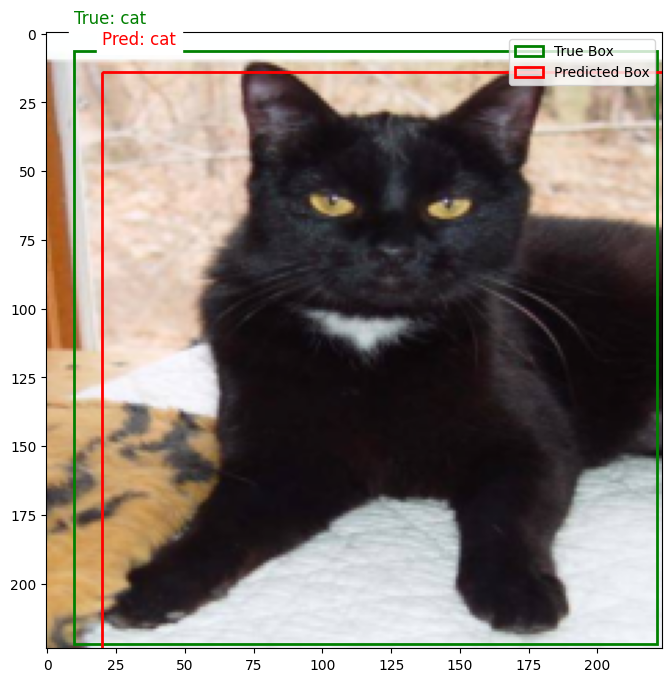

In [ ]:
import matplotlib.patches as patches

def show_image_with_bounding_box(image, true_box, pred_box, true_label, pred_label):
    if isinstance(image, torch.Tensor):  # преобразование тензора в numpy, если необходимо
        image = image.permute(1, 2, 0).numpy()
        image = image * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]  # обратная нормализация
        image = image.clip(0, 1)

    fig, ax = plt.subplots(1, figsize=(8, 8))
    ax.imshow(image)

    # истинный bounding box
    if true_box:
        ax.add_patch(patches.Rectangle(
            (true_box[0], true_box[1]), # верхний левый угол
            true_box[2] - true_box[0], # ширина
            true_box[3] - true_box[1], # высота
            linewidth=2, edgecolor="green", facecolor="none", label="True Box"
        ))
        plt.text(
            true_box[0], true_box[1] - 10, f"True: {true_label}",
            color="green", fontsize=12, backgroundcolor="white"
        )

    # предсказанный bounding box
    if pred_box:
        ax.add_patch(patches.Rectangle(
            (pred_box[0], pred_box[1]),
            pred_box[2] - pred_box[0],
            pred_box[3] - pred_box[1],
            linewidth=2, edgecolor="red", facecolor="none", label="Predicted Box"
        ))
        plt.text(
            pred_box[0], pred_box[1] - 10, f"Pred: {pred_label}",
            color="red", fontsize=12, backgroundcolor="white"
        )

    plt.legend(loc="upper right")
    plt.show()

# валидация модели с визуализацией
model.eval()
with torch.no_grad():
    for imgs, boxes, labels in val_loader:
        imgs = imgs.to("cuda")
        preds_class, preds_bbox = model(imgs)

        for i in range(len(imgs)):
            # извлечение изображения
            img = imgs[i].cpu()

            # истинные значения bounding box и метка
            true_box = [
                boxes["xmin"][i].item() * img.shape[2],
                boxes["ymin"][i].item() * img.shape[1],
                boxes["xmax"][i].item() * img.shape[2],
                boxes["ymax"][i].item() * img.shape[1]
            ]
            true_label = labels[i]  # истинная метка класса

            # предсказания: bounding box и метка
            pred_box = [
                preds_bbox[i][0].item() * img.shape[2],
                preds_bbox[i][1].item() * img.shape[1],
                preds_bbox[i][2].item() * img.shape[2],
                preds_bbox[i][3].item() * img.shape[1]
            ]
            pred_label = list(label_mapping.keys())[torch.argmax(preds_class[i]).item()]  # предсказанный класс

            # визуализация
            show_image_with_bounding_box(
                img,
                true_box=true_box,
                pred_box=pred_box,
                true_label=true_label,
                pred_label=pred_label
            )
        break

### Cравнение моделей

Без SC:

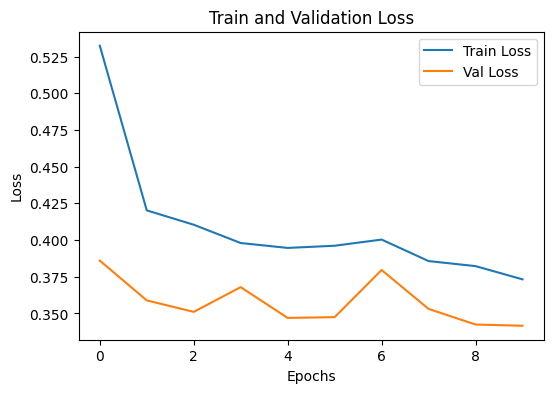

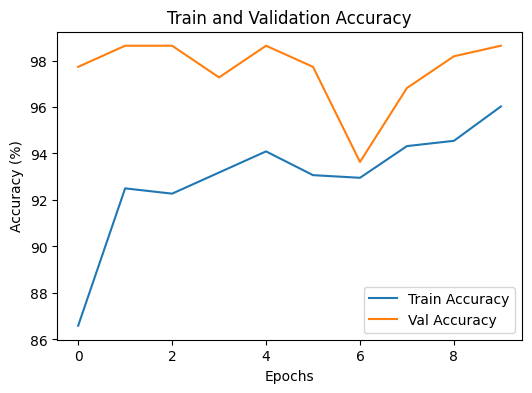

In [ ]:
plt.figure(figsize=(6, 4))
plt.plot(train_losses, label="Train Loss")
plt.plot(val_losses, label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Train and Validation Loss")
plt.legend()
plt.show()

plt.figure(figsize=(6, 4))
plt.plot(train_accuracies, label="Train Accuracy")
plt.plot(val_accuracies, label="Val Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.title("Train and Validation Accuracy")
plt.legend()
plt.show()

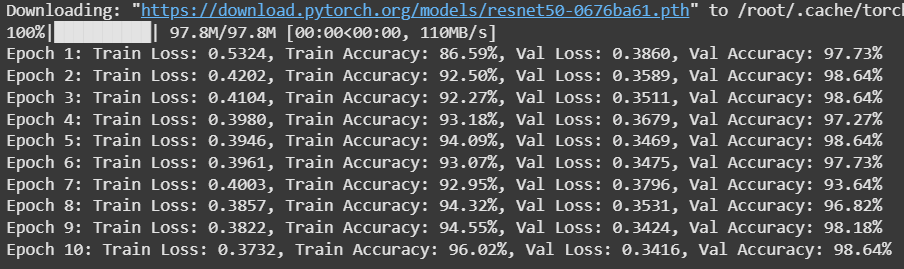

вместе с SC:

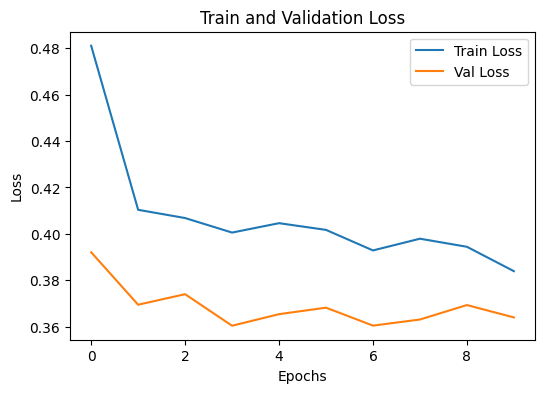

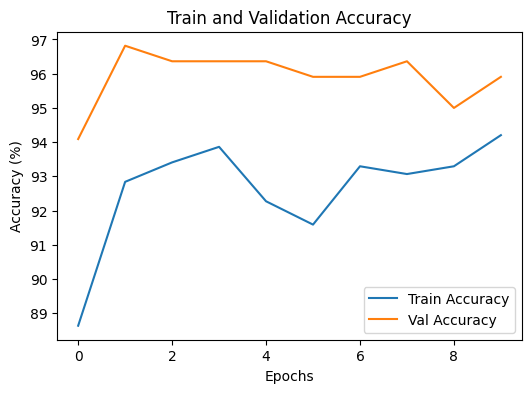

In [ ]:
plt.figure(figsize=(6, 4))
plt.plot(train_losses, label="Train Loss")
plt.plot(val_losses, label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Train and Validation Loss")
plt.legend()
plt.show()

plt.figure(figsize=(6, 4))
plt.plot(train_accuracies, label="Train Accuracy")
plt.plot(val_accuracies, label="Val Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.title("Train and Validation Accuracy")
plt.legend()
plt.show()

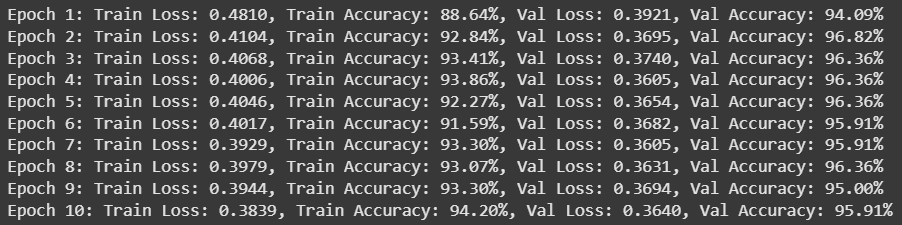

### обучение v 1.1:

<p class="task" id="4"></p>
4. Напишите модель для решения задачи выделения объектов. Реализуйте двухголовую сеть, одна голова которой предсказывает метку объекта (задача классификации), а вторая голова предсказывает 4 координаты вершин bounding box (задача регрессии). В качестве backbone используйте модель resnet50 из пакета `torchvision`.

- [ ] Проверено на семинаре

In [ ]:
import torch
import torch.nn as nn
from torchvision.models import resnet50

class ObjectDetectionModel(nn.Module):
    def __init__(self, num_classes):
        super(ObjectDetectionModel, self).__init__()
        self.backbone = resnet50(pretrained=True)
        self.backbone = nn.Sequential(*list(self.backbone.children())[:-2])  # Без FC слоя -  удаляем линейный FC слой и avg pool

        self.class_head = nn.Sequential(   # классификация
            nn.Flatten(),
            nn.Linear(2048, 512),
            nn.ReLU(),
            nn.Linear(512, num_classes)
        )

        self.bbox_head = nn.Sequential(  # регрессия
            nn.Flatten(),
            nn.Linear(2048, 512),
            nn.ReLU(),
            nn.Linear(512, 4)  # x_min, y_min, x_max, y_max
        )

    def forward(self, x):
        features = self.backbone(x)
        classification = self.class_head(features)
        bounding_box = self.bbox_head(features)

        return classification, bounding_box

In [ ]:
class ObjectDetectionModel_N(nn.Module):
    def __init__(self, num_classes):
        super(ObjectDetectionModel_N, self).__init__()
        backbone = resnet50(pretrained=True, weights='IMAGENET1K_V1')  # для torch >= 0.13.0
        self.backbone = nn.Sequential(*list(backbone.children())[:-2])  # убираем последний слой классификации
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))  # pooling для уменьшения размерности
        self.freeze_backbone()  # заморозка backbone для ускорения обучения

        self.fc_class = nn.Linear(2048, num_classes)  # классификация (кол-во классов)
        self.fc_bbox = nn.Linear(2048, 4)  # регрессия (координаты bbox)

    def freeze_backbone(self): # заморозка слоев backbone для ускорения обучения
        for param in self.backbone.parameters():
            param.requires_grad = False

    def forward(self, x):
        x = self.backbone(x)
        x = self.avgpool(x)
        x = torch.flatten(x, 1)  # Преобразование к [batch_size, features]

        # Две головы
        class_output = self.fc_class(x)  # Предсказания класса
        bbox_output = self.fc_bbox(x)  # Координаты bbox
        return class_output, bbox_output

In [ ]:
import torch
import torch.nn as nn
from torchvision.models import resnet50

class ObjectDetectionModel(nn.Module):
    def __init__(self, num_classes):
        super(ObjectDetectionModel, self).__init__()
        # Загружаем backbone с предварительно обученными весами
        backbone = resnet50(pretrained=True)
        self.backbone = nn.Sequential(*list(backbone.children())[:-2])  # Убираем последний слой классификации
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))  # Уменьшаем размерность до (1, 1)

        # Замораживаем слои backbone для ускорения обучения
        self.freeze_backbone()

        # Голова для классификации (выход: num_classes)
        self.fc_class = nn.Sequential(
            nn.Linear(2048, 512),
            nn.ReLU(),
            nn.Dropout(0.3),  # Dropout для борьбы с переобучением
            nn.Linear(512, num_classes),
            nn.Softmax(dim=1)  # Softmax для вероятностей классов
        )

        # Голова для регрессии координат (выход: 4)
        self.fc_bbox = nn.Sequential(
            nn.Linear(2048, 512),
            nn.ReLU(),
            nn.Dropout(0.3),  # Dropout для улучшения обобщающей способности
            nn.Linear(512, 4)
        )

    def freeze_backbone(self):
        """Заморозка всех параметров backbone для ускорения обучения."""
        for param in self.backbone.parameters():
            param.requires_grad = False

    def forward(self, x):
        # Извлечение признаков с помощью backbone
        x = self.backbone(x)
        x = self.avgpool(x)
        x = torch.flatten(x, 1)  # Преобразуем в вектор [batch_size, features]

        # Прогон через две головы
        class_output = self.fc_class(x)  # Предсказание класса
        bbox_output = self.fc_bbox(x)  # Предсказание координат bbox

        return class_output, bbox_output


In [ ]:
import torch
import torch.nn as nn
from torchvision.models import resnet50

class ObjectDetectionModel_sc(nn.Module):
    def __init__(self, num_classes):
        super(ObjectDetectionModel_sc, self).__init__()
        # Загружаем backbone с предварительно обученными весами
        backbone = resnet50(pretrained=True)
        self.backbone = nn.Sequential(*list(backbone.children())[:-2])  # Убираем последний слой классификации
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))  # Уменьшаем размерность до (1, 1)

        self.freeze_backbone()

        # для классификации (выход: num_classes)
        self.fc_class = nn.Sequential(
            nn.Linear(2048 + 2048, 512),  # увеличиваем входные признаки для skip connection
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(512, num_classes),
            nn.Softmax(dim=1)
        )

        # для регрессии координат (выход: 4)
        self.fc_bbox = nn.Sequential(
            nn.Linear(2048 + 2048, 512),  # увеличиваем входные признаки для skip connection
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(512, 4)
        )

    def freeze_backbone(self):
        for param in self.backbone.parameters():
            param.requires_grad = False

    def forward(self, x):
        # Извлечение признаков с помощью backbone
        features = self.backbone(x)
        pooled_features = self.avgpool(features)
        pooled_features = torch.flatten(pooled_features, 1)  # Преобразуем в вектор [batch_size, features]

        # Добавляем skip connection: соединяем признаки до и после пулинга
        skip_connection = torch.flatten(features, 1)  # Преобразуем оригинальные признаки в вектор
        combined_features = torch.cat([pooled_features, skip_connection], dim=1)  # Объединяем вдоль оси признаков

        # Прогон через две головы
        class_output = self.fc_class(combined_features)  # Предсказание класса
        bbox_output = self.fc_bbox(combined_features)  # Предсказание координат bbox

        return class_output, bbox_output


<p class="task" id="5"></p>

5\. Разбейте набор данных на обучающее и валидационное множество. Обучите модель, описанную в задаче 4. При создании датасета не забудьте указать преобразования, соответствующие модели ResNet.

Используйте сумму MSELoss (для расчета ошибки на задаче регрессии) и CrossEntropyLoss (для расчета ошибки на задачи классификации) для настройки весов модели. Для ускорения процесса обучения слои backbone можно заморозить. Во время обучения выводите на экран значения функции потерь на обучающем и валидационном множестве. Используя обученную модель, получите предсказания для изображения кошки и собаки и отрисуйте их. Выполните процедуру, обратную нормализации, чтобы корректно отобразить фотографии.

- [ ] Проверено на семинаре

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, random_split
import torchvision.transforms as T
from torchvision.models import resnet50
import matplotlib.pyplot as plt

transforms = T.Compose([
    T.Resize((224, 224)),  # Размер для ResNet
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Нормализация для ResNet
])

dataset = AnimalDetectionDataset("animals.zip", transforms=transforms)

train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8)

class ObjectDetectionModel_N(nn.Module):
    def __init__(self, num_classes):
        super(ObjectDetectionModel_N, self).__init__()
        # Используем ResNet50 в качестве backbone
        backbone = resnet50(weights='IMAGENET1K_V1')  # Подходит для torch >= 0.13.0
        self.backbone = nn.Sequential(*list(backbone.children())[:-2])  # Убираем последний слой классификации
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))  # Pooling для уменьшения размерности
        self.freeze_backbone()  # Заморозка backbone для ускорения обучения

        # Две "головы"
        self.fc_class = nn.Linear(2048, num_classes)  # Классификация (кол-во классов)
        self.fc_bbox = nn.Linear(2048, 4)  # Регрессия (координаты bbox)

    def freeze_backbone(self):
        """Заморозка слоев backbone для ускорения обучения."""
        for param in self.backbone.parameters():
            param.requires_grad = False

    def forward(self, x):
        # Прогон через backbone
        x = self.backbone(x)
        x = self.avgpool(x)
        x = torch.flatten(x, 1)  # Преобразование к [batch_size, features]

        # Две головы
        class_output = self.fc_class(x)  # Предсказания класса
        bbox_output = self.fc_bbox(x)  # Координаты bbox
        return class_output, bbox_output

#model = ObjectDetectionModel(num_classes=2).to("cuda")

In [ ]:
model = ObjectDetectionModel_N(num_classes=2).to("cuda")

optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4)
criterion_class = nn.CrossEntropyLoss()
criterion_bbox = nn.MSELoss()

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []

label_mapping = {'cat': 0, 'dog': 1}

for epoch in range(10):
    model.train()
    train_loss, correct_train, total_train = 0.0, 0, 0

    for imgs, boxes, labels in train_loader:
        imgs = imgs.to("cuda")
        boxes_tensor = torch.stack(
            [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
            dim=1
        ).to("cuda").float()
        labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

        preds_class, preds_bbox = model(imgs)
        loss_class = criterion_class(preds_class, labels_tensor)
        loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
        loss = loss_class + loss_bbox

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        _, predicted = torch.max(preds_class, 1)
        total_train += labels_tensor.size(0)
        correct_train += (predicted == labels_tensor).sum().item()

    train_losses.append(train_loss / len(train_loader))
    train_accuracies.append(correct_train / total_train * 100)

    model.eval()
    val_loss, correct_val, total_val = 0.0, 0, 0
    with torch.no_grad():
        for imgs, boxes, labels in val_loader:
            imgs = imgs.to("cuda")
            boxes_tensor = torch.stack(
                [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
                dim=1
            ).to("cuda").float()
            labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

            preds_class, preds_bbox = model(imgs)
            loss_class = criterion_class(preds_class, labels_tensor)
            loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
            val_loss += loss_class.item() + loss_bbox.item()

            _, predicted = torch.max(preds_class, 1)
            total_val += labels_tensor.size(0)
            correct_val += (predicted == labels_tensor).sum().item()

    val_losses.append(val_loss / len(val_loader))
    val_accuracies.append(correct_val / total_val * 100)

    print(f"Epoch {epoch+1}: Train Loss: {train_losses[-1]:.4f}, Train Accuracy: {train_accuracies[-1]:.2f}%, "
          f"Val Loss: {val_losses[-1]:.4f}, Val Accuracy: {val_accuracies[-1]:.2f}%")

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 185MB/s]


Epoch 1: Train Loss: 0.6109, Train Accuracy: 73.52%, Val Loss: 0.4278, Val Accuracy: 92.73%
Epoch 2: Train Loss: 0.3855, Train Accuracy: 88.75%, Val Loss: 0.2953, Val Accuracy: 96.82%
Epoch 3: Train Loss: 0.2956, Train Accuracy: 93.52%, Val Loss: 0.2394, Val Accuracy: 96.82%
Epoch 4: Train Loss: 0.2496, Train Accuracy: 94.20%, Val Loss: 0.2044, Val Accuracy: 96.36%
Epoch 5: Train Loss: 0.2242, Train Accuracy: 93.75%, Val Loss: 0.1810, Val Accuracy: 96.36%
Epoch 6: Train Loss: 0.2333, Train Accuracy: 92.27%, Val Loss: 0.1699, Val Accuracy: 96.36%
Epoch 7: Train Loss: 0.2271, Train Accuracy: 91.25%, Val Loss: 0.1610, Val Accuracy: 95.91%
Epoch 8: Train Loss: 0.1988, Train Accuracy: 93.75%, Val Loss: 0.1491, Val Accuracy: 96.82%
Epoch 9: Train Loss: 0.2044, Train Accuracy: 93.30%, Val Loss: 0.1463, Val Accuracy: 96.36%
Epoch 10: Train Loss: 0.1652, Train Accuracy: 95.00%, Val Loss: 0.1243, Val Accuracy: 96.36%


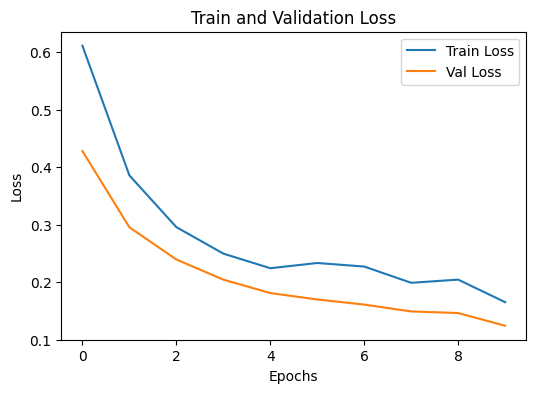

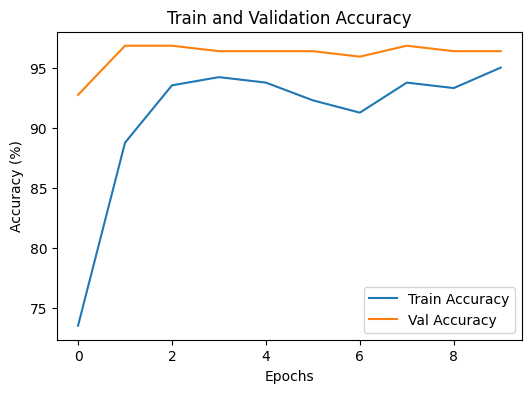

In [ ]:
plt.figure(figsize=(6, 4))
plt.plot(train_losses, label="Train Loss")
plt.plot(val_losses, label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Train and Validation Loss")
plt.legend()
plt.show()

plt.figure(figsize=(6, 4))
plt.plot(train_accuracies, label="Train Accuracy")
plt.plot(val_accuracies, label="Val Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.title("Train and Validation Accuracy")
plt.legend()
plt.show()

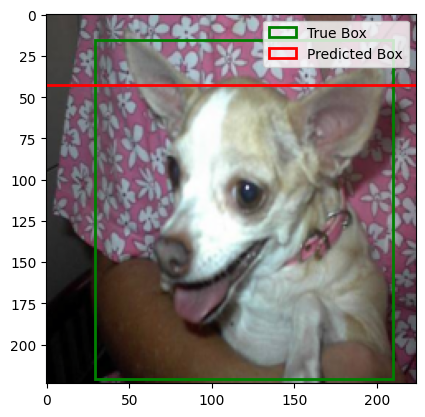

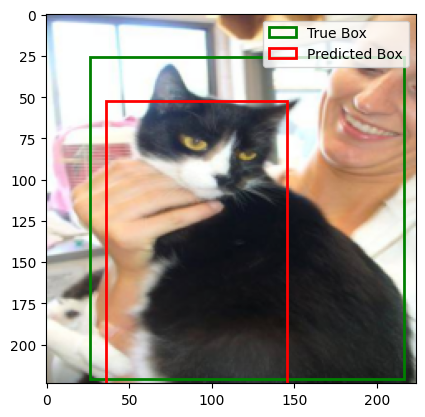

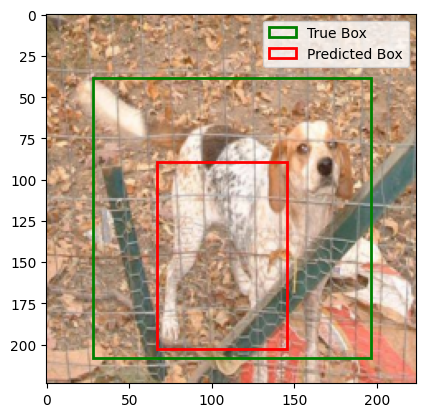

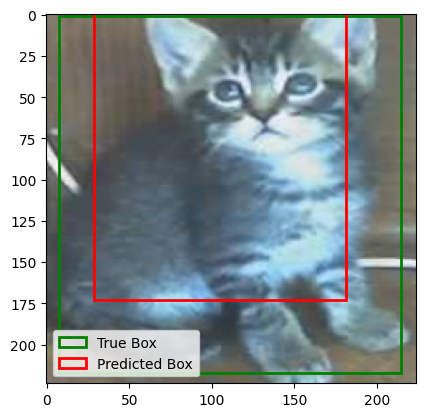

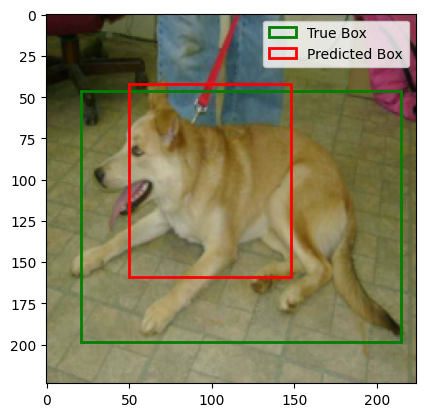

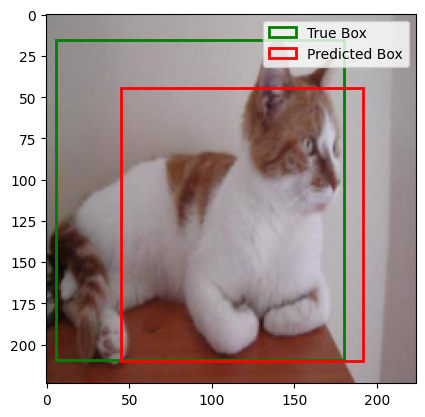

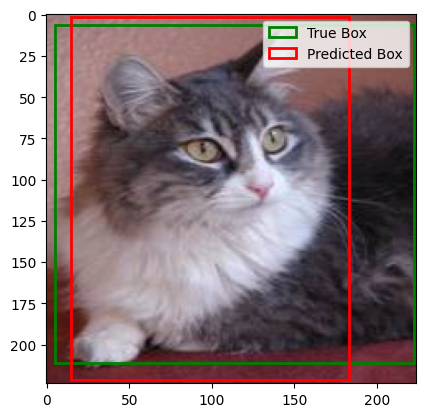

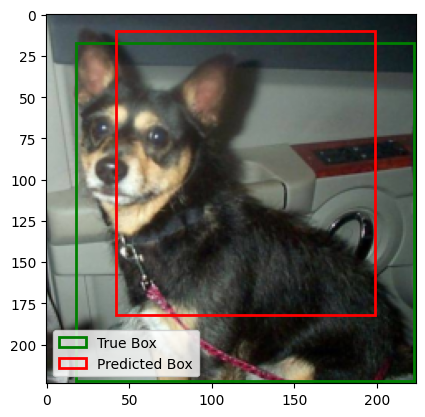

In [ ]:
model.eval()
with torch.no_grad():
    for imgs, boxes, labels in val_loader:
        imgs = imgs.to("cuda")
        preds_class, preds_bbox = model(imgs)

        for i in range(len(imgs)):
            # Извлечение изображения
            img = imgs[i].cpu().permute(1, 2, 0).numpy()
            img = img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]  # Обратная нормализация
            img = img.clip(0, 1)

            # Извлечение размеров изображения
            img_height, img_width = img.shape[:2]

            # Преобразование true_box
            true_box = [
                boxes["xmin"][i].item() * img_width,
                boxes["ymin"][i].item() * img_height,
                boxes["xmax"][i].item() * img_width,
                boxes["ymax"][i].item() * img_height
            ]

            # Преобразование pred_box
            pred_box = [
                preds_bbox[i][0].item() * img_width,
                preds_bbox[i][1].item() * img_height,
                preds_bbox[i][2].item() * img_width,
                preds_bbox[i][3].item() * img_height
            ]

            # Отрисовка
            plt.imshow(img)
            plt.gca().add_patch(plt.Rectangle(
                (true_box[0], true_box[1]),
                true_box[2] - true_box[0],
                true_box[3] - true_box[1],
                edgecolor="green", fill=False, linewidth=2, label="True Box"
            ))
            plt.gca().add_patch(plt.Rectangle(
                (pred_box[0], pred_box[1]),
                pred_box[2] - pred_box[0],
                pred_box[3] - pred_box[1],
                edgecolor="red", fill=False, linewidth=2, label="Predicted Box"
            ))
            plt.legend()
            plt.show()
        break

<p class="task" id="6"></p>

### 6\. Найдите в сети несколько изображений котов и собак. Используя любой инструмент для разметки (например, [CVAT](https://www.cvat.ai/)), выделите котов и собак на изображениях. Вставьте скриншот экспортированного файла с разметкой. Используя полученные изображения, визуализируйте разметку и bounding boxes, полученные при помощи модели.

- [ ] Проверено на семинаре

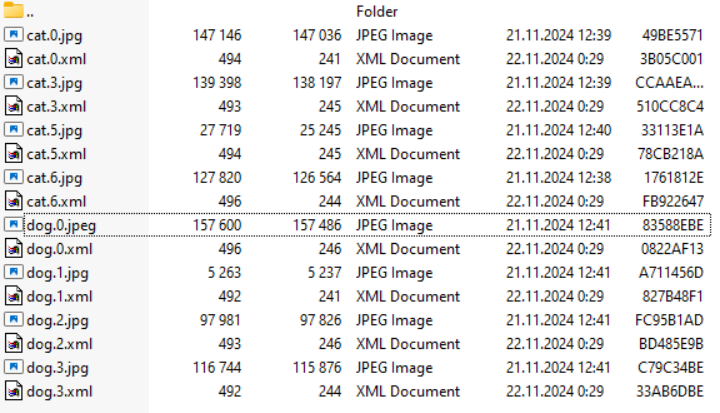

In [ ]:
dataset_2 = AnimalDetectionDataset("my_animals_2.zip", transforms=transforms)

#train_size = int(0.8 * len(dataset_2))
#val_size = len(dataset_2) - train_size
#train_dataset, val_dataset = random_split(dataset_2, [train_size, val_size])

#train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
#val_loader = DataLoader(val_dataset, batch_size=8)

loader = DataLoader(dataset_2, batch_size=8)

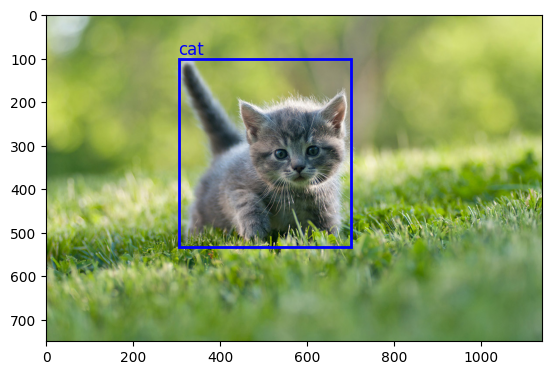

In [ ]:
def visualize_bounding_boxes(zip_path, xml_file, img_file):
    # Парсинг XML
    data = parse_xml(xml_file, zip_path)
    raw_box = data["raw"]
    label = data["obj_name"]

    # Извлечение изображения
    with zipfile.ZipFile(zip_path, 'r') as archive:
        with archive.open(img_file) as file:
            img = Image.open(file).convert("RGB")

    # Отрисовка
    fig, ax = plt.subplots(1)
    ax.imshow(img)
    rect = patches.Rectangle(
        (raw_box["xmin"], raw_box["ymin"]),
        raw_box["xmax"] - raw_box["xmin"],
        raw_box["ymax"] - raw_box["ymin"],
        linewidth=2,
        edgecolor="blue",
        facecolor="none"
    )
    ax.add_patch(rect)
    plt.text(raw_box["xmin"], raw_box["ymin"] - 10, label, color="blue", fontsize=12)
    plt.show()

visualize_bounding_boxes(
    zip_path="my_animals_2.zip",
    xml_file="my_animals_2/cat.0.xml",
    img_file="my_animals_2/cat.0.jpg"
)

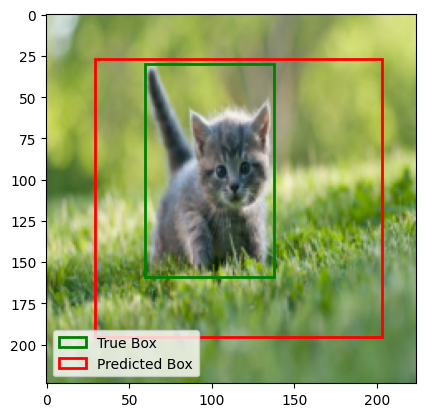

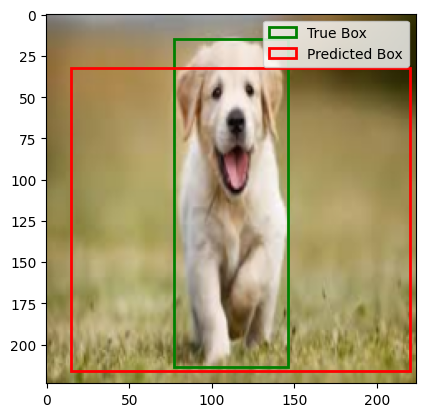

In [ ]:
model.eval()
with torch.no_grad():
    for imgs, boxes, labels in loader:
        imgs = imgs.to("cuda")
        preds_class, preds_bbox = model(imgs)

        for i in range(len(imgs)):
            # Извлечение изображения
            img = imgs[i].cpu().permute(1, 2, 0).numpy()
            img = img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]  # Обратная нормализация
            img = img.clip(0, 1)

            # Извлечение размеров изображения
            img_height, img_width = img.shape[:2]

            # Преобразование true_box
            true_box = [
                boxes["xmin"][i].item() * img_width,
                boxes["ymin"][i].item() * img_height,
                boxes["xmax"][i].item() * img_width,
                boxes["ymax"][i].item() * img_height
            ]

            # Преобразование pred_box
            pred_box = [
                preds_bbox[i][0].item() * img_width,
                preds_bbox[i][1].item() * img_height,
                preds_bbox[i][2].item() * img_width,
                preds_bbox[i][3].item() * img_height
            ]

            # Отрисовка
            plt.imshow(img)
            plt.gca().add_patch(plt.Rectangle(
                (true_box[0], true_box[1]),
                true_box[2] - true_box[0],
                true_box[3] - true_box[1],
                edgecolor="green", fill=False, linewidth=2, label="True Box"
            ))
            plt.gca().add_patch(plt.Rectangle(
                (pred_box[0], pred_box[1]),
                pred_box[2] - pred_box[0],
                pred_box[3] - pred_box[1],
                edgecolor="red", fill=False, linewidth=2, label="Predicted Box"
            ))
            plt.legend()
            plt.show()
        break

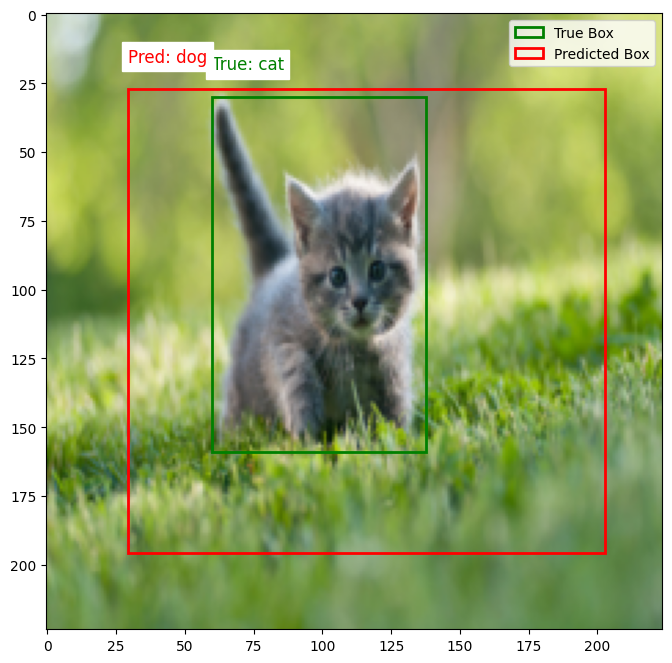

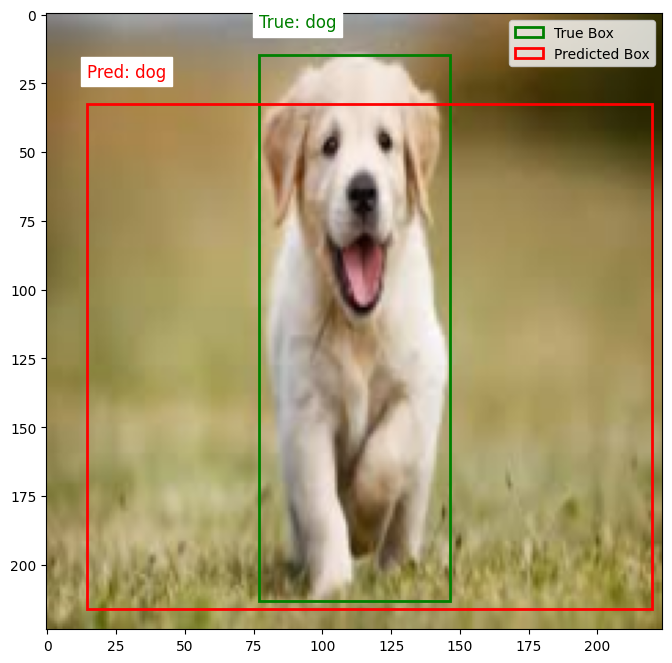

In [ ]:
# Валидация модели с визуализацией
model.eval()
with torch.no_grad():
    for imgs, boxes, labels in loader:
        imgs = imgs.to("cuda")
        preds_class, preds_bbox = model(imgs)

        for i in range(len(imgs)):
            # Извлечение изображения
            img = imgs[i].cpu()

            # Истинные значения bounding box и метка
            true_box = [
                boxes["xmin"][i].item() * img.shape[2],
                boxes["ymin"][i].item() * img.shape[1],
                boxes["xmax"][i].item() * img.shape[2],
                boxes["ymax"][i].item() * img.shape[1]
            ]
            true_label = labels[i]  # Истинная метка класса

            # Предсказания: bounding box и метка
            pred_box = [
                preds_bbox[i][0].item() * img.shape[2],
                preds_bbox[i][1].item() * img.shape[1],
                preds_bbox[i][2].item() * img.shape[2],
                preds_bbox[i][3].item() * img.shape[1]
            ]
            pred_label = list(label_mapping.keys())[torch.argmax(preds_class[i]).item()]  # Предсказанный класс

            # Визуализация
            show_image_with_bounding_box(
                img,
                true_box=true_box,
                pred_box=pred_box,
                true_label=true_label,
                pred_label=pred_label
            )
        break


#### Старое:

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, random_split
import torchvision.transforms as T
from torchvision.models import resnet50
import matplotlib.pyplot as plt

transforms = T.Compose([
    T.Resize((224, 224)),  # Размер для ResNet
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Нормализация для ResNet
])

dataset = AnimalDetectionDataset("my_animals_all.zip", transforms=transforms)

train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size

train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8)

class ObjectDetectionModel_N(nn.Module):
    def __init__(self, num_classes):
        super(ObjectDetectionModel_N, self).__init__()
        # Используем ResNet50 в качестве backbone
        backbone = resnet50(weights='IMAGENET1K_V1')  # Подходит для torch >= 0.13.0
        self.backbone = nn.Sequential(*list(backbone.children())[:-2])  # Убираем последний слой классификации
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))  # Pooling для уменьшения размерности
        self.freeze_backbone()  # Заморозка backbone для ускорения обучения

        # Две "головы"
        self.fc_class = nn.Linear(2048, num_classes)  # Классификация (кол-во классов)
        self.fc_bbox = nn.Linear(2048, 4)  # Регрессия (координаты bbox)

    def freeze_backbone(self):
        """Заморозка слоев backbone для ускорения обучения."""
        for param in self.backbone.parameters():
            param.requires_grad = False

    def forward(self, x):
        # Прогон через backbone
        x = self.backbone(x)
        x = self.avgpool(x)
        x = torch.flatten(x, 1)  # Преобразование к [batch_size, features]

        # Две головы
        class_output = self.fc_class(x)  # Предсказания класса
        bbox_output = self.fc_bbox(x)  # Координаты bbox
        return class_output, bbox_output

#model = ObjectDetectionModel(num_classes=2).to("cuda")

In [ ]:

transforms = T.Compose([
    T.Resize((224, 224)),  # Размер для ResNet
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Нормализация для ResNet
])

dataset = AnimalDetectionDataset("my_animals_1.zip", transforms=transforms)

train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size

train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8)

class ObjectDetectionModel_N(nn.Module):
    def __init__(self, num_classes):
        super(ObjectDetectionModel_N, self).__init__()
        # Используем ResNet50 в качестве backbone
        backbone = resnet50(weights='IMAGENET1K_V1')  # Подходит для torch >= 0.13.0
        self.backbone = nn.Sequential(*list(backbone.children())[:-2])  # Убираем последний слой классификации
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))  # Pooling для уменьшения размерности
        self.freeze_backbone()  # Заморозка backbone для ускорения обучения

        # Две "головы"
        self.fc_class = nn.Linear(2048, num_classes)  # Классификация (кол-во классов)
        self.fc_bbox = nn.Linear(2048, 4)  # Регрессия (координаты bbox)

    def freeze_backbone(self):
        """Заморозка слоев backbone для ускорения обучения."""
        for param in self.backbone.parameters():
            param.requires_grad = False

    def forward(self, x):
        # Прогон через backbone
        x = self.backbone(x)
        x = self.avgpool(x)
        x = torch.flatten(x, 1)  # Преобразование к [batch_size, features]

        # Две головы
        class_output = self.fc_class(x)  # Предсказания класса
        bbox_output = self.fc_bbox(x)  # Координаты bbox
        return class_output, bbox_output

model = ObjectDetectionModel_N(num_classes=2).to("cuda")

optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4)
criterion_class = nn.CrossEntropyLoss()
criterion_bbox = nn.MSELoss()

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []

label_mapping = {'cat': 0, 'dog': 1}

for epoch in range(10):
    model.train()
    train_loss, correct_train, total_train = 0.0, 0, 0

    for imgs, boxes, labels in train_loader:
        imgs = imgs.to("cuda")
        boxes_tensor = torch.stack(
            [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
            dim=1
        ).to("cuda").float()
        labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

        preds_class, preds_bbox = model(imgs)
        loss_class = criterion_class(preds_class, labels_tensor)
        loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
        loss = loss_class + loss_bbox

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        _, predicted = torch.max(preds_class, 1)
        total_train += labels_tensor.size(0)
        correct_train += (predicted == labels_tensor).sum().item()

    train_losses.append(train_loss / len(train_loader))
    train_accuracies.append(correct_train / total_train * 100)

    # Валидация
    model.eval()
    val_loss, correct_val, total_val = 0.0, 0, 0
    with torch.no_grad():
        for imgs, boxes, labels in val_loader:
            imgs = imgs.to("cuda")
            boxes_tensor = torch.stack(
                [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
                dim=1
            ).to("cuda").float()
            labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

            preds_class, preds_bbox = model(imgs)
            loss_class = criterion_class(preds_class, labels_tensor)
            loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
            val_loss += loss_class.item() + loss_bbox.item()

            _, predicted = torch.max(preds_class, 1)
            total_val += labels_tensor.size(0)
            correct_val += (predicted == labels_tensor).sum().item()

    val_losses.append(val_loss / len(val_loader))
    val_accuracies.append(correct_val / total_val * 100)

    print(f"Epoch {epoch+1}: Train Loss: {train_losses[-1]:.4f}, Train Accuracy: {train_accuracies[-1]:.2f}%, "
          f"Val Loss: {val_losses[-1]:.4f}, Val Accuracy: {val_accuracies[-1]:.2f}%")

Epoch 1: Train Loss: 1.0118, Train Accuracy: 40.00%, Val Loss: 0.8782, Val Accuracy: 50.00%
Epoch 2: Train Loss: 0.9065, Train Accuracy: 40.00%, Val Loss: 0.7950, Val Accuracy: 50.00%
Epoch 3: Train Loss: 0.8254, Train Accuracy: 40.00%, Val Loss: 0.7255, Val Accuracy: 100.00%
Epoch 4: Train Loss: 0.7652, Train Accuracy: 40.00%, Val Loss: 0.6733, Val Accuracy: 100.00%
Epoch 5: Train Loss: 0.7226, Train Accuracy: 40.00%, Val Loss: 0.6422, Val Accuracy: 100.00%
Epoch 6: Train Loss: 0.6936, Train Accuracy: 60.00%, Val Loss: 0.6254, Val Accuracy: 100.00%
Epoch 7: Train Loss: 0.6733, Train Accuracy: 80.00%, Val Loss: 0.6135, Val Accuracy: 50.00%
Epoch 8: Train Loss: 0.6571, Train Accuracy: 80.00%, Val Loss: 0.6071, Val Accuracy: 50.00%
Epoch 9: Train Loss: 0.6417, Train Accuracy: 80.00%, Val Loss: 0.6045, Val Accuracy: 50.00%
Epoch 10: Train Loss: 0.6255, Train Accuracy: 80.00%, Val Loss: 0.6026, Val Accuracy: 50.00%


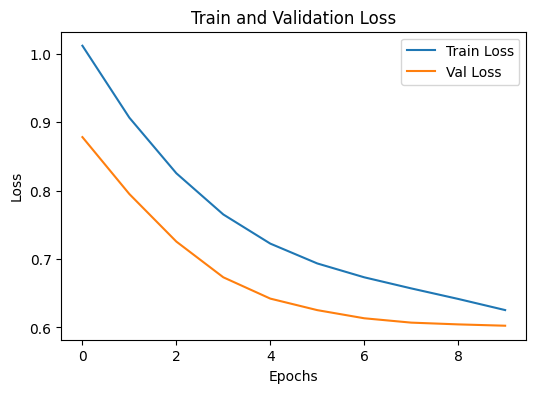

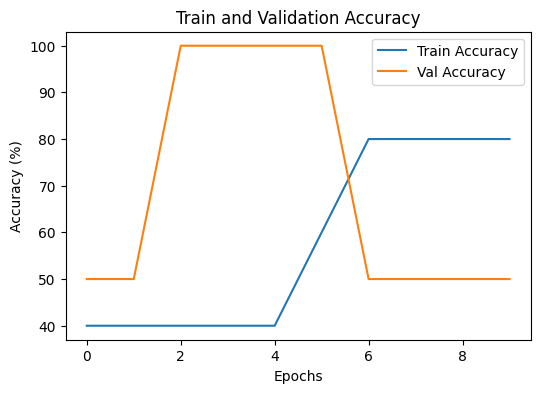

In [ ]:

plt.figure(figsize=(6, 4))
plt.plot(train_losses, label="Train Loss")
plt.plot(val_losses, label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Train and Validation Loss")
plt.legend()
plt.show()

plt.figure(figsize=(6, 4))
plt.plot(train_accuracies, label="Train Accuracy")
plt.plot(val_accuracies, label="Val Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.title("Train and Validation Accuracy")
plt.legend()
plt.show()

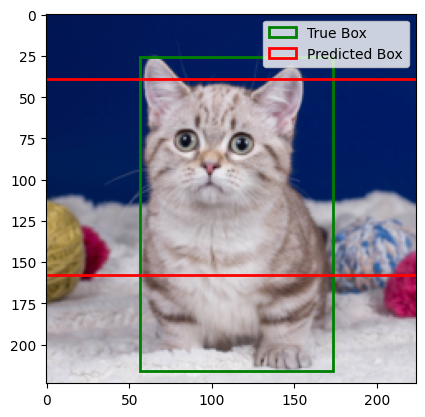

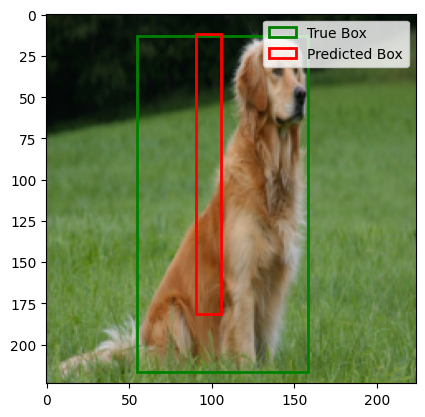

In [ ]:
model.eval()
with torch.no_grad():
    for imgs, boxes, labels in val_loader:
        imgs = imgs.to("cuda")
        preds_class, preds_bbox = model(imgs)

        for i in range(len(imgs)):
            # Извлечение изображения
            img = imgs[i].cpu().permute(1, 2, 0).numpy()
            img = img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]  # Обратная нормализация
            img = img.clip(0, 1)

            # Извлечение размеров изображения
            img_height, img_width = img.shape[:2]

            # Преобразование true_box
            true_box = [
                boxes["xmin"][i].item() * img_width,
                boxes["ymin"][i].item() * img_height,
                boxes["xmax"][i].item() * img_width,
                boxes["ymax"][i].item() * img_height
            ]

            # Преобразование pred_box
            pred_box = [
                preds_bbox[i][0].item() * img_width,
                preds_bbox[i][1].item() * img_height,
                preds_bbox[i][2].item() * img_width,
                preds_bbox[i][3].item() * img_height
            ]

            # Отрисовка
            plt.imshow(img)
            plt.gca().add_patch(plt.Rectangle(
                (true_box[0], true_box[1]),
                true_box[2] - true_box[0],
                true_box[3] - true_box[1],
                edgecolor="green", fill=False, linewidth=2, label="True Box"
            ))
            plt.gca().add_patch(plt.Rectangle(
                (pred_box[0], pred_box[1]),
                pred_box[2] - pred_box[0],
                pred_box[3] - pred_box[1],
                edgecolor="red", fill=False, linewidth=2, label="Predicted Box"
            ))
            plt.legend()
            plt.show()
        break

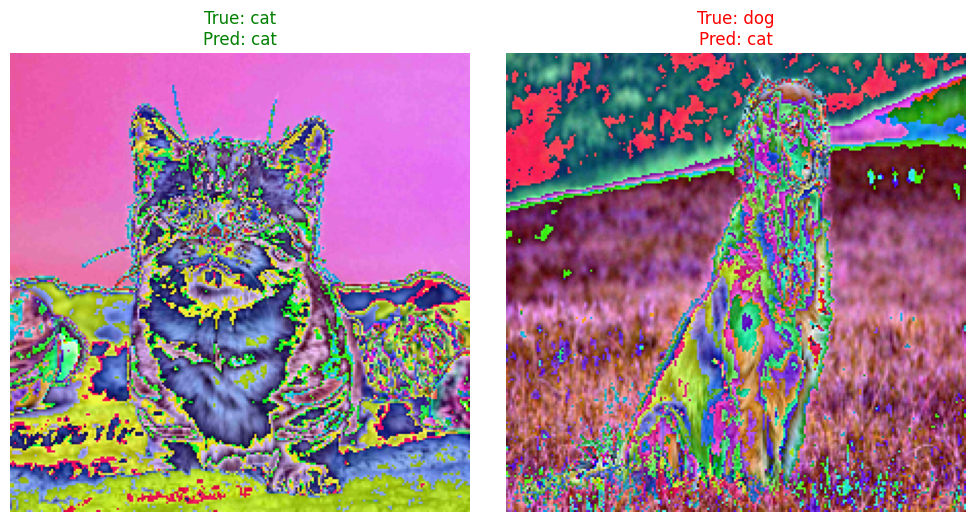

In [ ]:
import matplotlib.pyplot as plt
import torchvision.transforms.functional as F

# Функция для отображения изображений с предсказаниями
def visualize_predictions(model, loader, label_mapping, num_images=8):
    model.eval()
    inv_label_mapping = {v: k for k, v in label_mapping.items()}  # Обратное отображение меток

    imgs, boxes, labels = next(iter(loader))
    imgs = imgs.to("cuda")

    # Истинные метки и предсказания
    true_labels = [inv_label_mapping[label_mapping[label]] for label in labels]
    with torch.no_grad():
        preds_class, preds_bbox = model(imgs)
        _, predicted = torch.max(preds_class, 1)
        predicted_labels = [inv_label_mapping[pred.item()] for pred in predicted]

    # Отображение изображений
    plt.figure(figsize=(20, 10))
    for i in range(min(num_images, len(imgs))):
        img = F.to_pil_image(imgs[i].cpu())
        true_label = true_labels[i]
        pred_label = predicted_labels[i]
        box = boxes["xmin"][i], boxes["ymin"][i], boxes["xmax"][i], boxes["ymax"][i]

        plt.subplot(2, 4, i + 1)
        plt.imshow(img)
        plt.title(f"True: {true_label}\nPred: {pred_label}", color="green" if true_label == pred_label else "red")
        plt.axis("off")

    plt.tight_layout()
    plt.show()

# Вызов функции
visualize_predictions(model, val_loader, label_mapping, num_images=8)

<p class="task" id="7"></p>

### 7*\. Повторите решение предыдущей задачи, используя модель `fasterrcnn_resnet50_fpn`. Замените слой для предсказания bounding box на `FastRCNNPredictor` с нужным количеством классов.

- [ ] Проверено на семинаре

In [ ]:
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

model = fasterrcnn_resnet50_fpn(pretrained=True)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes=3)  # 2 класса + фон

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:00<00:00, 173MB/s]


In [ ]:
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.ops import box_iou  # Для расчета IoU
from torchvision.models.detection import FasterRCNN_ResNet50_FPN_Weights

# Загружаем модель с предобученными весами
weights = FasterRCNN_ResNet50_FPN_Weights.DEFAULT
model = fasterrcnn_resnet50_fpn(weights=weights)

# Создаем модель Faster R-CNN
def create_model(num_classes):
    # Загрузим предобученную модель Faster R-CNN
    weights = FasterRCNN_ResNet50_FPN_Weights.DEFAULT
    model = fasterrcnn_resnet50_fpn(weights=weights)
    #model = fasterrcnn_resnet50_fpn(pretrained=True)

    # Заменим слой классификации (box predictor) на наш
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    return model

num_classes = 3  # Два класса (кошка и собака) + фон
model = create_model(num_classes).to("cuda")
label_mapping = {'dog': 1, 'cat': 2, 'background': 0}

optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4)

# Функция для расчета IoU и точности
def calculate_accuracy(predictions, targets, iou_threshold=0.5):
    correct_boxes = 0
    total_boxes = 0
    for pred, target in zip(predictions, targets):
        pred_boxes = pred["boxes"].detach().cpu()
        pred_labels = pred["labels"].detach().cpu()
        target_boxes = target["boxes"].detach().cpu()
        target_labels = target["labels"].detach().cpu()

        # Рассчитываем IoU
        iou_matrix = box_iou(pred_boxes, target_boxes)
        matches = (iou_matrix > iou_threshold).float()

        for pred_idx, row in enumerate(matches):
            if row.max() > 0:  # Если есть совпадение
                target_idx = row.argmax()
                if pred_labels[pred_idx] == target_labels[target_idx]:
                    correct_boxes += 1

        total_boxes += len(target_boxes)

    accuracy = correct_boxes / total_boxes if total_boxes > 0 else 0.0
    return accuracy

def train_faster_rcnn(model, train_loader, val_loader, epochs=10):
    for epoch in range(epochs):
        model.train()  # Режим тренировки
        train_loss = 0
        train_accuracy = 0

        for imgs, boxes, labels in train_loader:
            imgs = list(img.to("cuda") for img in imgs)
            targets = []
            for i in range(len(labels)):
                targets.append({
                    "boxes": torch.tensor([
                        [boxes["xmin"][i], boxes["ymin"][i], boxes["xmax"][i], boxes["ymax"][i]]
                    ]).float().to("cuda"),
                    "labels": torch.tensor([label_mapping[labels[i]]]).to("cuda"),
                })

            optimizer.zero_grad()
            # Передаём и изображения, и метки
            losses = model(imgs, targets)
            loss = sum(loss for loss in losses.values())
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        # Валидация
        model.eval()  # Режим оценки
        val_accuracy = 0
        with torch.no_grad():
            for imgs, boxes, labels in val_loader:
                imgs = list(img.to("cuda") for img in imgs)
                predictions = model(imgs)
                # Реализуйте функцию calculate_accuracy для подсчёта accuracy
                val_accuracy += calculate_accuracy(predictions, targets)
        model.train()  # Вернуть в режим тренировки

        print(f"Epoch {epoch + 1}/{epochs}, Train Loss: {train_loss / len(train_loader):.4f}")#, Val Accuracy: {val_accuracy / len(val_loader):.4f}")


# Обучение модели
#train_faster_rcnn(model, train_loader, val_loader, epochs=10)


Epoch 1/10, Train Loss: 4.8723
Epoch 2/10, Train Loss: 0.9762
Epoch 3/10, Train Loss: 0.7499
Epoch 4/10, Train Loss: 0.3494
Epoch 5/10, Train Loss: 0.2875
Epoch 6/10, Train Loss: 0.3043
Epoch 7/10, Train Loss: 0.1905
Epoch 8/10, Train Loss: 0.2256
Epoch 9/10, Train Loss: 0.1757
Epoch 10/10, Train Loss: 0.1631


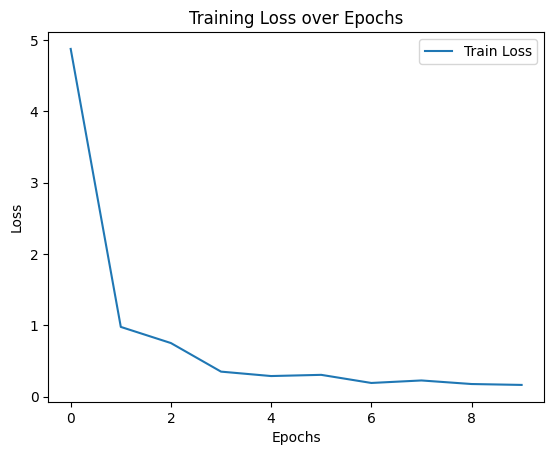

In [ ]:
import matplotlib.pyplot as plt

# Изменение функции обучения для сохранения потерь по эпохам
def train_faster_rcnn(model, train_loader, val_loader, epochs=10):
    epoch_losses = []  # Список для хранения потерь по эпохам
    for epoch in range(epochs):
        model.train()  # Режим тренировки
        train_loss = 0

        for imgs, boxes, labels in train_loader:
            imgs = list(img.to("cuda") for img in imgs)
            targets = []
            for i in range(len(labels)):
                targets.append({
                    "boxes": torch.tensor([
                        [boxes["xmin"][i], boxes["ymin"][i], boxes["xmax"][i], boxes["ymax"][i]]
                    ]).float().to("cuda"),
                    "labels": torch.tensor([label_mapping[labels[i]]]).to("cuda"),
                })

            optimizer.zero_grad()
            losses = model(imgs, targets)
            loss = sum(loss for loss in losses.values())
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        epoch_losses.append(train_loss / len(train_loader))  # Добавляем среднее значение потерь за эпоху

        # Валидация
        model.eval()  # Режим оценки
        val_accuracy = 0
        with torch.no_grad():
            for imgs, boxes, labels in val_loader:
                imgs = list(img.to("cuda") for img in imgs)
                predictions = model(imgs)
                val_accuracy += calculate_accuracy(predictions, targets)

        model.train()  # Вернуть в режим тренировки
        print(f"Epoch {epoch + 1}/{epochs}, Train Loss: {train_loss / len(train_loader):.4f}")

    # Построение графика потерь
    plt.plot(range(epochs), epoch_losses, label='Train Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss over Epochs')
    plt.legend()
    plt.show()

# Обучение модели
train_faster_rcnn(model, train_loader, val_loader, epochs=10)


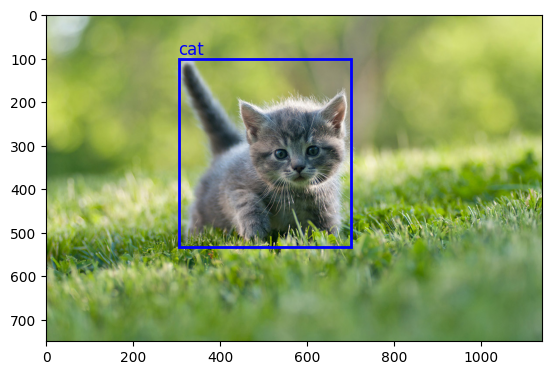

In [ ]:
visualize_bounding_boxes(
    zip_path="my_animals_2.zip",
    xml_file="my_animals_2/cat.0.xml",
    img_file="my_animals_2/cat.0.jpg"
)

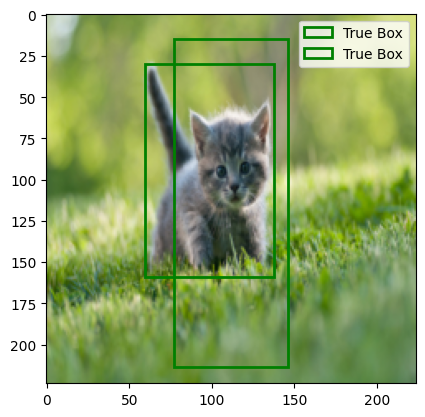

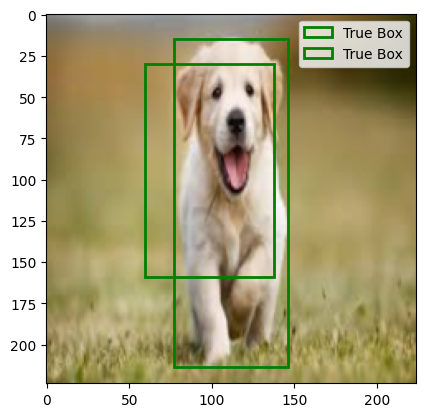

In [ ]:
model.eval()
with torch.no_grad():
    for imgs, boxes, labels in loader:
        imgs = list(img.to("cuda") for img in imgs)  # Преобразование в список тензоров
        predictions = model(imgs)  # Предсказания модели

        for img, prediction, label in zip(imgs, predictions, labels):
            # Извлечение изображения
            img = img.cpu().permute(1, 2, 0).numpy()
            img = img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]  # Обратная нормализация
            img = img.clip(0, 1)

            # Истинные боксы
            true_boxes = [
                [
                    boxes["xmin"][i] * img.shape[1],
                    boxes["ymin"][i] * img.shape[0],
                    boxes["xmax"][i] * img.shape[1],
                    boxes["ymax"][i] * img.shape[0],
                ]
                for i in range(len(boxes["xmin"]))
            ]

            # Предсказанные боксы
            pred_boxes = prediction['boxes'].cpu().numpy()

            # Визуализация
            plt.imshow(img)
            for box in true_boxes:
                plt.gca().add_patch(plt.Rectangle(
                    (box[0], box[1]),
                    box[2] - box[0],
                    box[3] - box[1],
                    edgecolor="green", fill=False, linewidth=2, label="True Box"
                ))
            for box in pred_boxes:
                plt.gca().add_patch(plt.Rectangle(
                    (box[0], box[1]),
                    box[2] - box[0],
                    box[3] - box[1],
                    edgecolor="red", fill=False, linewidth=2, label="Predicted Box"
                ))
            plt.legend()
            plt.show()
        break


In [ ]:
model.eval()
with torch.no_grad():
    for imgs, boxes, labels in loader:
        imgs = imgs.to("cuda")
        preds_class, preds_bbox = model(imgs)

        for i in range(len(imgs)):
            # Извлечение изображения
            img = imgs[i].cpu().permute(1, 2, 0).numpy()
            img = img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]  # Обратная нормализация
            img = img.clip(0, 1)

            # Извлечение размеров изображения
            img_height, img_width = img.shape[:2]

            # Преобразование true_box
            true_box = [
                boxes["xmin"][i].item() * img_width,
                boxes["ymin"][i].item() * img_height,
                boxes["xmax"][i].item() * img_width,
                boxes["ymax"][i].item() * img_height
            ]

            # Преобразование pred_box
            pred_box = [
                preds_bbox[i][0].item() * img_width,
                preds_bbox[i][1].item() * img_height,
                preds_bbox[i][2].item() * img_width,
                preds_bbox[i][3].item() * img_height
            ]

            # Отрисовка
            plt.imshow(img)
            plt.gca().add_patch(plt.Rectangle(
                (true_box[0], true_box[1]),
                true_box[2] - true_box[0],
                true_box[3] - true_box[1],
                edgecolor="green", fill=False, linewidth=2, label="True Box"
            ))
            plt.gca().add_patch(plt.Rectangle(
                (pred_box[0], pred_box[1]),
                pred_box[2] - pred_box[0],
                pred_box[3] - pred_box[1],
                edgecolor="red", fill=False, linewidth=2, label="Predicted Box"
            ))
            plt.legend()
            plt.show()
        break

KeyError: 0

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

def visualize_predictions(images, predictions, targets=None, label_mapping=None):
    """
    Визуализация предсказанных и истинных bounding boxes.

    :param images: Список тензоров изображений
    :param predictions: Предсказания модели
    :param targets: Истинная разметка (опционально)
    :param label_mapping: Словарь для отображения индексов классов в названия
    """
    for img, preds, target in zip(images, predictions, targets or [None]*len(predictions)):
        # Перевести изображение в формат [H, W, C]
        img = img.permute(1, 2, 0).cpu().numpy()
        img = (img - img.min()) / (img.max() - img.min())  # Нормализация для визуализации

        fig, ax = plt.subplots(1, 1, figsize=(8, 8))
        ax.imshow(img)

        # Рисуем предсказанные боксы
        for box, label in zip(preds["boxes"].detach().cpu(), preds["labels"].detach().cpu()):
            x_min, y_min, x_max, y_max = box
            rect = patches.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min,
                                      linewidth=2, edgecolor='r', facecolor='none', label='Prediction')
            ax.add_patch(rect)
            label_name = label_mapping.get(label.item(), label.item()) if label_mapping else label.item()
            ax.text(x_min, y_min, f"{label_name}", color='r', fontsize=10, bbox=dict(facecolor='white', alpha=0.5))

        # Рисуем истинные боксы (если есть)
        if target:
            for box, label in zip(target["boxes"].detach().cpu(), target["labels"].detach().cpu()):
                x_min, y_min, x_max, y_max = box
                rect = patches.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min,
                                          linewidth=2, edgecolor='g', facecolor='none', label='Target')
                ax.add_patch(rect)
                label_name = label_mapping.get(label.item(), label.item()) if label_mapping else label.item()
                ax.text(x_min, y_min, f"{label_name}", color='g', fontsize=10, bbox=dict(facecolor='white', alpha=0.5))

        ax.legend(["Prediction", "Target"])
        plt.show()


In [ ]:
def create_model(num_classes):
    # Загрузим предобученную модель Faster R-CNN
    model = fasterrcnn_resnet50_fpn(pretrained=True)

    # Заменим слой классификации (box predictor) на наш
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    return model

num_classes = 3  # Два класса (кошка и собака) + фон
model = create_model(num_classes).to("cuda")

# Настраиваем оптимизатор и функцию потерь
optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4)

def train_faster_rcnn(model, train_loader, val_loader, epochs=10):
    model.train()
    for epoch in range(epochs):
        train_loss = 0
        for imgs, boxes, labels in train_loader:
            imgs = list(img.to("cuda") for img in imgs)
            targets = []
            for i in range(len(labels)):
                # Преобразуем боксы и метки в нужный формат
                targets.append({
                    "boxes": torch.tensor([
                        [boxes["xmin"][i], boxes["ymin"][i], boxes["xmax"][i], boxes["ymax"][i]]
                    ]).float().to("cuda"),
                    "labels": torch.tensor([label_mapping[labels[i]]]).to("cuda"),
                })

            # Обнуляем градиенты
            optimizer.zero_grad()
            # Вычисляем потери
            losses = model(imgs, targets)
            loss = sum(loss for loss in losses.values())
            # Обновляем веса
            loss.backward()
            optimizer.step()

            train_loss += loss.item()

        print(f"Epoch {epoch + 1}/{epochs}, Train Loss: {train_loss / len(train_loader):.4f}")

    return model

# Обучение модели
model = train_faster_rcnn(model, train_loader, val_loader, epochs=10)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 98.2MB/s]


Epoch 1/10, Train Loss: 3.8118
Epoch 2/10, Train Loss: 0.8929
Epoch 3/10, Train Loss: 0.6512
Epoch 4/10, Train Loss: 0.2790
Epoch 5/10, Train Loss: 0.3333
Epoch 6/10, Train Loss: 0.2947
Epoch 7/10, Train Loss: 0.1678
Epoch 8/10, Train Loss: 0.1921
Epoch 9/10, Train Loss: 0.1723
Epoch 10/10, Train Loss: 0.1179


In [ ]:
for epoch in range(10):
    model.train()
    train_loss, correct_train, total_train = 0.0, 0, 0

    for imgs, boxes, labels in train_loader:

        imgs = list(img.to("cuda") for img in imgs)
        targets = []
        for i in range(len(labels)):
                # Преобразуем боксы и метки в нужный формат
            targets.append({
                    "boxes": torch.tensor([
                        [boxes["xmin"][i], boxes["ymin"][i], boxes["xmax"][i], boxes["ymax"][i]]
                    ]).float().to("cuda"),
                    "labels": torch.tensor([label_mapping[labels[i]]]).to("cuda"),
            })

            # Обнуляем градиенты
            #optimizer.zero_grad()


        #imgs = imgs.to("cuda")
        #boxes_tensor = torch.stack(
            #[boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
            #dim=1
        #).to("cuda").float()
        labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

        preds_class, preds_bbox = model(imgs)
        loss_class = criterion_class(preds_class, labels_tensor)
        loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
        loss = loss_class + loss_bbox

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        _, predicted = torch.max(preds_class, 1)
        total_train += labels_tensor.size(0)
        correct_train += (predicted == labels_tensor).sum().item()

    train_losses.append(train_loss / len(train_loader))
    train_accuracies.append(correct_train / total_train * 100)

    model.eval()
    val_loss, correct_val, total_val = 0.0, 0, 0
    with torch.no_grad():
        for imgs, boxes, labels in val_loader:
            imgs = imgs.to("cuda")
            boxes_tensor = torch.stack(
                [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
                dim=1
            ).to("cuda").float()
            labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

            preds_class, preds_bbox = model(imgs)
            loss_class = criterion_class(preds_class, labels_tensor)
            loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
            val_loss += loss_class.item() + loss_bbox.item()

            _, predicted = torch.max(preds_class, 1)
            total_val += labels_tensor.size(0)
            correct_val += (predicted == labels_tensor).sum().item()

    val_losses.append(val_loss / len(val_loader))
    val_accuracies.append(correct_val / total_val * 100)

    print(f"Epoch {epoch+1}: Train Loss: {train_losses[-1]:.4f}, Train Accuracy: {train_accuracies[-1]:.2f}%, "
          f"Val Loss: {val_losses[-1]:.4f}, Val Accuracy: {val_accuracies[-1]:.2f}%")

AssertionError: targets should not be none when in training mode

In [ ]:
model.eval()
with torch.no_grad():
    for imgs, boxes, labels in loader:
        imgs = imgs.to("cuda")
        preds_class, preds_bbox = model(imgs)

        for i in range(len(imgs)):
            # Извлечение изображения
            img = imgs[i].cpu().permute(1, 2, 0).numpy()
            img = img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]  # Обратная нормализация
            img = img.clip(0, 1)

            # Извлечение размеров изображения
            img_height, img_width = img.shape[:2]

            # Преобразование true_box
            true_box = [
                boxes["xmin"][i].item() * img_width,
                boxes["ymin"][i].item() * img_height,
                boxes["xmax"][i].item() * img_width,
                boxes["ymax"][i].item() * img_height
            ]

            # Преобразование pred_box
            pred_box = [
                preds_bbox[i][0].item() * img_width,
                preds_bbox[i][1].item() * img_height,
                preds_bbox[i][2].item() * img_width,
                preds_bbox[i][3].item() * img_height
            ]

            # Отрисовка
            plt.imshow(img)
            plt.gca().add_patch(plt.Rectangle(
                (true_box[0], true_box[1]),
                true_box[2] - true_box[0],
                true_box[3] - true_box[1],
                edgecolor="green", fill=False, linewidth=2, label="True Box"
            ))
            plt.gca().add_patch(plt.Rectangle(
                (pred_box[0], pred_box[1]),
                pred_box[2] - pred_box[0],
                pred_box[3] - pred_box[1],
                edgecolor="red", fill=False, linewidth=2, label="Predicted Box"
            ))
            plt.legend()
            plt.show()
        break

KeyError: 0

In [ ]:
from torch.utils.data import Dataset
from PIL import Image
import torchvision.transforms as T
import torch
import zipfile

class AnimalDetectionDataset(Dataset):
    def __init__(self, root, transforms=None, target_transform=None, return_scaled=True):
        self.root = root
        self.transforms = transforms
        self.target_transform = target_transform
        self.return_scaled = return_scaled

        with zipfile.ZipFile(root, 'r') as archive:
            self.xml_files = [f for f in archive.namelist() if f.endswith('.xml')]

    def __len__(self):
        return len(self.xml_files)

    def __getitem__(self, idx):
        xml_file = self.xml_files[idx]
        img_file = xml_file.replace(".xml", ".jpg")

        # Загружаем изображение
        with zipfile.ZipFile(self.root, 'r') as archive:
            with archive.open(img_file) as file:
                img = Image.open(file).convert("RGB")

        # Загружаем аннотации
        data = parse_xml(xml_file, self.root)
        print(f"Data from XML: {data}")  # Отладочный вывод

        # Извлечение боксов
        box_dicts = data["scaled"] if self.return_scaled else data["raw"]
        if isinstance(box_dicts, dict):  # Если это один словарь, преобразуем его в список
            box_dicts = [box_dicts]

        # Преобразуем боксы в формат [[xmin, ymin, xmax, ymax], ...]
        boxes = [[d["xmin"], d["ymin"], d["xmax"], d["ymax"]] for d in box_dicts]

        # Извлечение меток классов
        labels = data["obj_name"]
        if isinstance(labels, str):  # Если метка одна, преобразуем её в список
            labels = [labels]

        # Преобразуем метки в индексы классов (пример для 2 классов)
        labels_tensor = torch.tensor(
            [0 if obj == "cat" else 1 for obj in labels],  # Пример кодировки: "cat" -> 1, "dog" -> 2
            dtype=torch.int64
        )

        # Преобразуем боксы в тензор
        boxes_tensor = torch.tensor(boxes, dtype=torch.float32)

        # Применяем преобразования к изображению
        if self.transforms:
            img = self.transforms(img)

        # Возвращаем изображение и словарь с боксовыми аннотациями
        target = {
            "boxes": boxes_tensor,
            "labels": labels_tensor
        }

        return img, target

In [ ]:
data = parse_xml(xml_file, self.root)
print(data)  # Вывод содержимого для отладки
box_dicts = data["scaled"] if self.return_scaled else data["raw"]

# Если box_dicts — это строка, ошибка на этом этапе подтвердится
print(box_dicts)

NameError: name 'xml_file' is not defined

In [ ]:
import torch
import torchvision
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torch.utils.data import DataLoader
from PIL import Image
import torchvision.transforms as T
import numpy as np
import os



# --- Преобразования ---
transforms = T.Compose([
    T.ToTensor(),  # Faster R-CNN принимает изображения в формате Tensor
])

dataset = AnimalDetectionDataset("my_animals_1.zip", transforms=transforms)

# --- Разделение на тренировочную и валидационную выборки ---
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))


# --- Настройка Faster R-CNN ---
num_classes = 3  # 2 класса (cat, dog) + фон
model = fasterrcnn_resnet50_fpn(pretrained=True)

# Заменяем предсказатель (box_predictor)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

# --- Обучение ---
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)

# Оптимизатор
optimizer = torch.optim.AdamW(params=model.parameters(), lr=1e-4)

# Функция обучения
def train_one_epoch(model, optimizer, data_loader, device):
    model.train()
    total_loss = 0.0
    for images, targets in data_loader:
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        # Рассчитываем потери
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        # Обновляем веса
        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        total_loss += losses.item()
    return total_loss / len(data_loader)


# Функция валидации
def evaluate(model, data_loader, device):
    model.eval()  # Установить модель в режим оценки
    total_loss = 0.0

    with torch.no_grad():  # Отключаем градиенты
        for images, targets in data_loader:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            # Проверка, возвращает ли модель предсказания или словарь потерь
            output = model(images)  # В режиме eval возвращает предсказания
            if isinstance(output, list):  # Если это список предсказаний
                print("Predictions (example):", output[:1])  # Отладка
                continue  # Валидировать на основе метрик
            else:
                raise ValueError("Unexpected output format during evaluation.")
    return total_loss / len(data_loader)

'''
def evaluate(model, data_loader, device):
    model.eval()  # Установить модель в режим оценки
    total_loss = 0.0

    with torch.no_grad():  # Отключаем градиенты
        for images, targets in data_loader:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            # Проверка, возвращает ли модель предсказания или словарь потерь
            output = model(images)  # В режиме eval возвращает предсказания
            if isinstance(output, list):  # Если это список предсказаний
                print("Predictions (example):", output[:1])  # Отладка
                continue  # Валидировать на основе метрик
            else:
                raise ValueError("Unexpected output format during evaluation.")
    return total_loss / len(data_loader)
'''


# --- Цикл обучения ---
num_epochs = 10
for epoch in range(num_epochs):
    train_loss = train_one_epoch(model, optimizer, train_loader, device)
    val_loss = evaluate(model, val_loader, device)

    print(f"Epoch {epoch + 1}/{num_epochs}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}")

Data from XML: {'raw': {'xmin': 304.0, 'ymin': 100.0, 'xmax': 700.0, 'ymax': 533.0}, 'scaled': {'xmin': 0.26666666666666666, 'ymin': 0.13333333333333333, 'xmax': 0.6140350877192983, 'ymax': 0.7106666666666667}, 'obj_name': 'cat'}
Data from XML: {'raw': {'xmin': 234.0, 'ymin': 32.0, 'xmax': 677.0, 'ymax': 523.0}, 'scaled': {'xmin': 0.24375, 'ymin': 0.05925925925925926, 'xmax': 0.7052083333333333, 'ymax': 0.9685185185185186}, 'obj_name': 'dog'}
Data from XML: {'raw': {'xmin': 521.0, 'ymin': 4.0, 'xmax': 1458.0, 'ymax': 640.0}, 'scaled': {'xmin': 0.325625, 'ymin': 0.006230529595015576, 'xmax': 0.91125, 'ymax': 0.9968847352024922}, 'obj_name': 'cat'}
Data from XML: {'raw': {'xmin': 229.0, 'ymin': 54.0, 'xmax': 737.0, 'ymax': 622.0}, 'scaled': {'xmin': 0.229, 'ymin': 0.08095952023988005, 'xmax': 0.737, 'ymax': 0.9325337331334332}, 'obj_name': 'dog'}
Data from XML: {'raw': {'xmin': 324.0, 'ymin': 148.0, 'xmax': 990.0, 'ymax': 1233.0}, 'scaled': {'xmin': 0.253125, 'ymin': 0.115625, 'xmax': 0.

In [ ]:
# 1. Настройка преобразований и датасета
transforms = T.Compose([
    T.Resize((224, 224)),  # Размер для ResNet
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Нормализация для ResNet
])

dataset = AnimalDetectionDataset("my_animals_1.zip", transforms=transforms)

train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size

train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8)

# 3. Оптимизатор и функции потерь
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4)
criterion_class = nn.CrossEntropyLoss()
criterion_bbox = nn.MSELoss()

# 4. Обучение и оценка
train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []

label_mapping = {'cat': 0, 'dog': 1}

for epoch in range(10):
    model.train()
    train_loss, correct_train, total_train = 0.0, 0, 0

    for imgs, boxes, labels in train_loader:
        imgs = imgs.to("cuda")
        boxes_tensor = torch.stack(
            [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
            dim=1
        ).to("cuda").float()
        labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

        preds_class, preds_bbox = model(imgs)
        loss_class = criterion_class(preds_class, labels_tensor)
        loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
        loss = loss_class + loss_bbox

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        _, predicted = torch.max(preds_class, 1)
        total_train += labels_tensor.size(0)
        correct_train += (predicted == labels_tensor).sum().item()

    train_losses.append(train_loss / len(train_loader))
    train_accuracies.append(correct_train / total_train * 100)

    # Валидация
    model.eval()
    val_loss, correct_val, total_val = 0.0, 0, 0
    with torch.no_grad():
        for imgs, boxes, labels in val_loader:
            imgs = imgs.to("cuda")
            boxes_tensor = torch.stack(
                [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
                dim=1
            ).to("cuda").float()
            labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

            preds_class, preds_bbox = model(imgs)
            loss_class = criterion_class(preds_class, labels_tensor)
            loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
            val_loss += loss_class.item() + loss_bbox.item()

            _, predicted = torch.max(preds_class, 1)
            total_val += labels_tensor.size(0)
            correct_val += (predicted == labels_tensor).sum().item()

    val_losses.append(val_loss / len(val_loader))
    val_accuracies.append(correct_val / total_val * 100)

    print(f"Epoch {epoch+1}: Train Loss: {train_losses[-1]:.4f}, Train Accuracy: {train_accuracies[-1]:.2f}%, "
          f"Val Loss: {val_losses[-1]:.4f}, Val Accuracy: {val_accuracies[-1]:.2f}%")

AssertionError: targets should not be none when in training mode

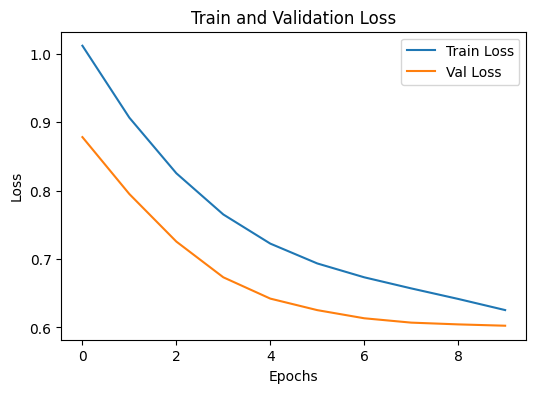

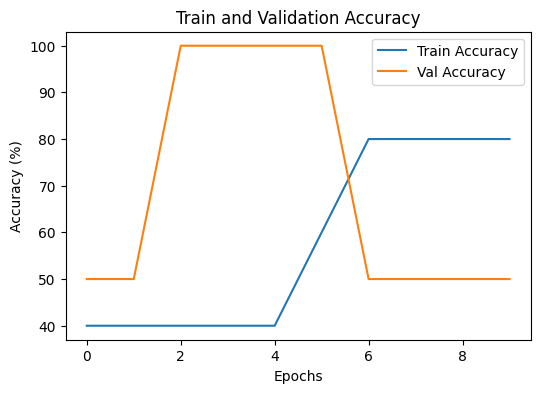

In [ ]:

# 5. Построение графиков
plt.figure(figsize=(6, 4))
plt.plot(train_losses, label="Train Loss")
plt.plot(val_losses, label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Train and Validation Loss")
plt.legend()
plt.show()

plt.figure(figsize=(6, 4))
plt.plot(train_accuracies, label="Train Accuracy")
plt.plot(val_accuracies, label="Val Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.title("Train and Validation Accuracy")
plt.legend()
plt.show()

In [ ]:
from torch.utils.data import Dataset
from PIL import Image
import torchvision.transforms as T

class AnimalDetectionDataset(Dataset):
    def __init__(self, root, transforms=None, target_transform=None, return_scaled=True):
        self.root = root
        self.transforms = transforms
        self.target_transform = target_transform
        self.return_scaled = return_scaled

        with zipfile.ZipFile(root, 'r') as archive:
            self.xml_files = [f for f in archive.namelist() if f.endswith('.xml')]

    def __len__(self):
        return len(self.xml_files)

    def __getitem__(self, idx):
        xml_file = self.xml_files[idx]
        img_file = xml_file.replace(".xml", ".jpg")

        with zipfile.ZipFile(self.root, 'r') as archive:
            with archive.open(img_file) as file:
                img = Image.open(file).convert("RGB")

        data = parse_xml(xml_file, self.root)
        box = data["scaled"] if self.return_scaled else data["raw"]
        label = data["obj_name"]

        if self.transforms:
            img = self.transforms(img)

        return img, box, label  # Убедитесь, что box - это словарь, а не строка

In [ ]:
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torch.utils.data import DataLoader, random_split
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.faster_rcnn import FasterRCNN_ResNet50_FPN_Weights

# Загрузка модели с актуальными весами
weights = FasterRCNN_ResNet50_FPN_Weights.COCO_V1
model = fasterrcnn_resnet50_fpn(weights=weights)

# Замена слоя для предсказания
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes=3)  # 2 класса + фон

# Настройка преобразований и датасета
transforms = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

dataset = AnimalDetectionDataset("my_animals_1.zip", transforms=transforms)

train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size

train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8)

# Подготовка модели Faster R-CNN
def get_fasterrcnn_model(num_classes):
    model = fasterrcnn_resnet50_fpn(pretrained=True)
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    return model

# Параметры обучения
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = get_fasterrcnn_model(num_classes=3)  # 2 класса + фон
model.to(device)

optimizer = optim.Adam(model.parameters(), lr=1e-4)
criterion_class = nn.CrossEntropyLoss()  # Для классификации
criterion_bbox = nn.MSELoss()  # Для регрессии

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []

label_mapping = {'cat': 0, 'dog': 1}

# Цикл обучения и оценки
for epoch in range(10):
    model.train()
    train_loss, correct_train, total_train = 0.0, 0, 0

    for imgs, boxes, labels in train_loader:
        imgs = [img.to(device) for img in imgs]
        print(boxes)
        targets = []
        for (key, box), label in zip(boxes.items(), labels):
            print(box)
            targets.append({
                "boxes": torch.tensor([
                    [box["xmin"].item(), box["ymin"].item(), box["xmax"].item(), box["ymax"].item()]
                ], dtype=torch.float32).to(device),
                "labels": torch.tensor([label_mapping[label]], dtype=torch.int64).to(device)
            })


        loss_dict = model(imgs, targets)
        loss = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()

        # Классификационная точность
        preds = model(imgs)
        for pred, target in zip(preds, targets):
            predicted_labels = pred["labels"]
            actual_labels = target["labels"]
            total_train += actual_labels.size(0)
            correct_train += (predicted_labels == actual_labels).sum().item()

    train_losses.append(train_loss / len(train_loader))
    train_accuracies.append(correct_train / total_train * 100)

    # Оценка на валидационной выборке
    model.eval()
    val_loss, correct_val, total_val = 0.0, 0, 0
    with torch.no_grad():
        for imgs, boxes, labels in val_loader:
            imgs = [img.to(device) for img in imgs]
            targets = []
            print(boxes[0]['xmin'])

            for box, label in zip(boxes, labels):
                print(box)
                #targets.append({
                #    "boxes": torch.tensor([[box["xmin"], box["ymin"], box["xmax"], box["ymax"]]], dtype=torch.float32).to(device),
                #    "labels": torch.tensor([label_mapping[label]], dtype=torch.int64).to(device)
                #})
                # Разделяем данные на индивидуальные значения для каждой метки
                targets.append({
                    "boxes": torch.tensor([
                        [box["xmin"].item(), box["ymin"].item(), box["xmax"].item(), box["ymax"].item()]
                    ], dtype=torch.float32).to(device),
                    "labels": torch.tensor([label_mapping[label]], dtype=torch.int64).to(device)
                })

            preds = model(imgs)
            for pred, target in zip(preds, targets):
                predicted_labels = pred["labels"]
                actual_labels = target["labels"]
                total_val += actual_labels.size(0)
                correct_val += (predicted_labels == actual_labels).sum().item()

            loss_dict = model(imgs, targets)
            val_loss += sum(loss for loss in loss_dict.values()).item()

    val_losses.append(val_loss / len(val_loader))
    val_accuracies.append(correct_val / total_val * 100)

    print(f"Epoch {epoch+1}: Train Loss: {train_losses[-1]:.4f}, Train Accuracy: {train_accuracies[-1]:.2f}%, "
          f"Val Loss: {val_losses[-1]:.4f}, Val Accuracy: {val_accuracies[-1]:.2f}%")

{'xmin': tensor([0.2531, 0.2667, 0.2290, 0.2754, 0.3433], dtype=torch.float64), 'ymin': tensor([0.1156, 0.1333, 0.0810, 0.3635, 0.0655], dtype=torch.float64), 'xmax': tensor([0.7734, 0.6140, 0.7370, 0.7549, 0.6533], dtype=torch.float64), 'ymax': tensor([0.9633, 0.7107, 0.9325, 0.7972, 0.9524], dtype=torch.float64)}
tensor([0.2531, 0.2667, 0.2290, 0.2754, 0.3433], dtype=torch.float64)


IndexError: too many indices for tensor of dimension 1

In [ ]:
imgs, boxes, labels = train_loader
imgs

TypeError: 'DataLoader' object is not subscriptable

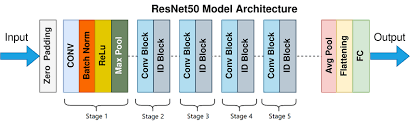

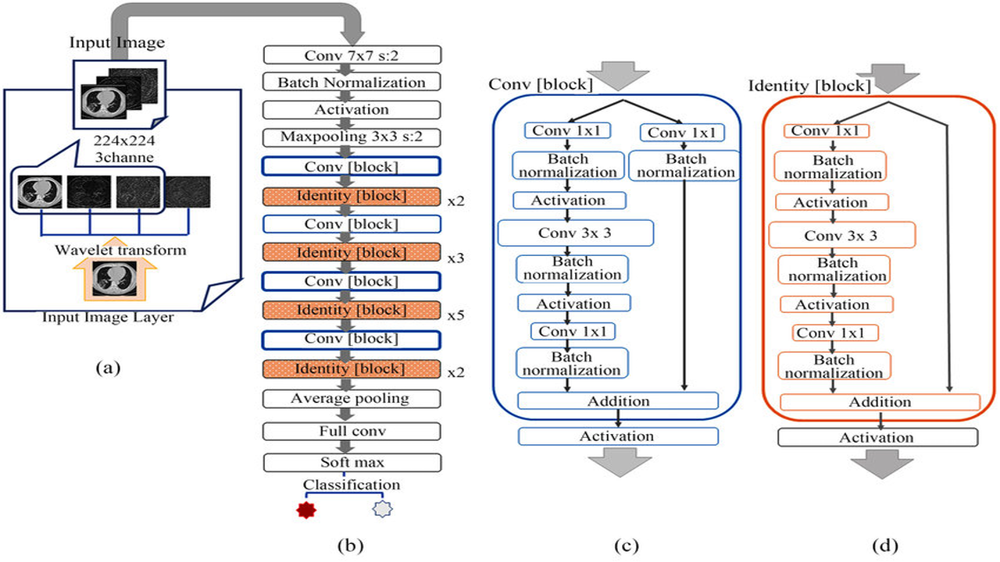

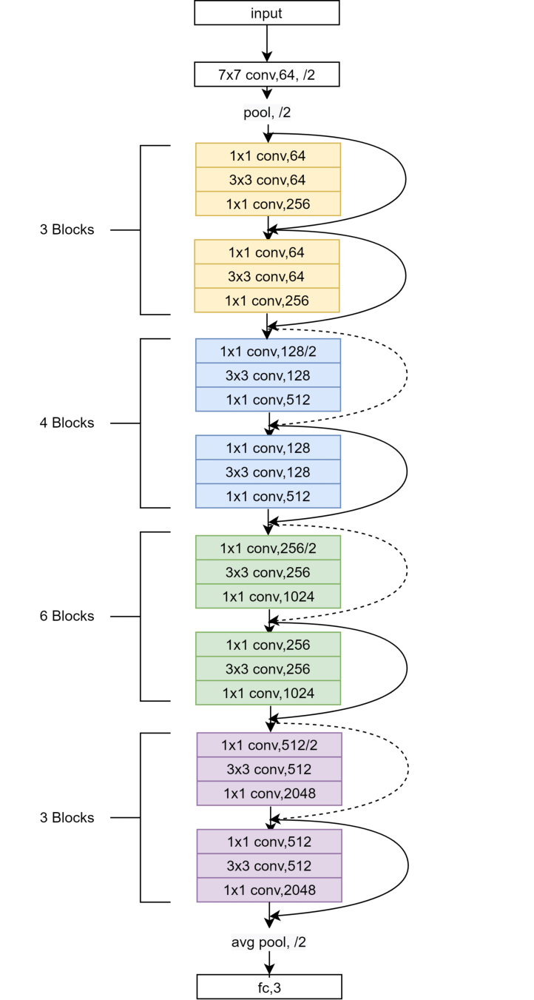

### Номера 4 и 5 в самый первый раз (v 1.0)

<p class="task" id="4"></p>

#### 4\. Напишите модель для решения задачи выделения объектов. Реализуйте двухголовую сеть, одна голова которой предсказывает метку объекта (задача классификации), а вторая голова предсказывает 4 координаты вершин bounding box (задача регрессии). В качестве backbone используйте модель resnet50 из пакета `torchvision`.

- [ ] Проверено на семинаре

In [ ]:
import torch
import torch.nn as nn
from torchvision.models import resnet50

class ObjectDetectionModel(nn.Module):
    def __init__(self, num_classes):
        super(ObjectDetectionModel, self).__init__()
        self.backbone = resnet50(pretrained=True)
        self.backbone = nn.Sequential(*list(self.backbone.children())[:-2])  # Без FC слоя -  удаляем линейный FC слой и avg pool

        self.class_head = nn.Sequential(   # классификация
            nn.Flatten(),
            nn.Linear(2048, 512),
            nn.ReLU(),
            nn.Linear(512, num_classes)
        )

        self.bbox_head = nn.Sequential(  # регрессия
            nn.Flatten(),
            nn.Linear(2048, 512),
            nn.ReLU(),
            nn.Linear(512, 4)  # x_min, y_min, x_max, y_max
        )

    def forward(self, x):
        features = self.backbone(x)
        classification = self.class_head(features)
        bounding_box = self.bbox_head(features)

        return classification, bounding_box

<p class="task" id="5"></p>

#### 5\. Разбейте набор данных на обучающее и валидационное множество. Обучите модель, описанную в задаче 4. При создании датасета не забудьте указать преобразования, соответствующие модели ResNet.

Используйте сумму MSELoss (для расчета ошибки на задаче регрессии) и CrossEntropyLoss (для расчета ошибки на задачи классификации) для настройки весов модели. Для ускорения процесса обучения слои backbone можно заморозить. Во время обучения выводите на экран значения функции потерь на обучающем и валидационном множестве. Используя обученную модель, получите предсказания для изображения кошки и собаки и отрисуйте их. Выполните процедуру, обратную нормализации, чтобы корректно отобразить фотографии.

- [ ] Проверено на семинаре

In [ ]:
class ObjectDetectionModel(nn.Module):
    def __init__(self, num_classes):
        super(ObjectDetectionModel, self).__init__()
        self.backbone = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.fc_class = nn.Linear(32 * 56 * 56, num_classes)  # Для classification
        self.fc_bbox = nn.Linear(32 * 56 * 56, 4)  # Для bounding box

    def forward(self, x):
        x = self.backbone(x)
        x = torch.flatten(x, start_dim=1)  # Преобразуем в 2D [batch_size, features]
        class_out = self.fc_class(x)
        bbox_out = self.fc_bbox(x)
        return class_out, bbox_out


In [ ]:
from torch.utils.data import DataLoader
import torchvision.transforms as T
import torch.optim as optim

# Разделение на train и val
transforms = T.Compose([
    T.Resize((224, 224)),  # Преобразуем все изображения к размеру 224x224
    T.ToTensor(),
])
dataset = AnimalDetectionDataset("animals.zip", transforms=transforms)

train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8)

# Инициализация модели
model = ObjectDetectionModel(num_classes=2).to("cuda")
optimizer = optim.Adam(model.parameters(), lr=1e-4)
criterion_class = nn.CrossEntropyLoss()
criterion_bbox = nn.MSELoss()

label_mapping = {'cat': 0, 'dog': 1}

# Обучение
for epoch in range(10):
    model.train()
    train_loss = 0.0
    for imgs, boxes, labels in train_loader:
        # Преобразование boxes
        imgs = imgs.to("cuda")  # imgs — тензор
        #boxes = torch.tensor(boxes, dtype=torch.float32).to("cuda")
        boxes_tensor = torch.stack(
            [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
            dim=1
        ).to("cuda")  # Тензор формы [batch_size, 4]
        labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")
        #boxes = torch.tensor([list(b.values()) for b in boxes]).float().to("cuda")  # Преобразуем dict -> list -> tensor
        #labels = labels.to("cuda")  # labels — тензор
        #print(labels)
        #break

    #for imgs, boxes, labels in train_loader:
        #imgs, labels = imgs.to("cuda"), labels.to("cuda")
        preds_class, preds_bbox = model(imgs)

        loss_class = criterion_class(preds_class, labels_tensor)
        loss_bbox = criterion_bbox(preds_bbox, torch.tensor(boxes_tensor).float()).to("cuda")
        loss = loss_class + loss_bbox

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
    print(f"Epoch {epoch+1}, Train Loss: {train_loss / len(train_loader)}")

<ipython-input-15-11bb2eb1e900>:50: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  loss_bbox = criterion_bbox(preds_bbox, torch.tensor(boxes_tensor).float()).to("cuda")


Epoch 1, Train Loss: 0.7349920603361997
Epoch 2, Train Loss: 0.6657632974061098
Epoch 3, Train Loss: 0.6067361956292933
Epoch 4, Train Loss: 0.5669818802313371
Epoch 5, Train Loss: 0.5229354186491533
Epoch 6, Train Loss: 0.48352891586043617
Epoch 7, Train Loss: 0.4376096480272033
Epoch 8, Train Loss: 0.40735024823383853
Epoch 9, Train Loss: 0.3731033639474349
Epoch 10, Train Loss: 0.3301736694167961


In [ ]:
import matplotlib.pyplot as plt
# Инициализация модели
model = ObjectDetectionModel(num_classes=2).to("cuda")
optimizer = optim.Adam(model.parameters(), lr=1e-4)
criterion_class = nn.CrossEntropyLoss()
criterion_bbox = nn.MSELoss()

# Функция для оценки модели
def evaluate_model(model, val_loader, criterion_class, criterion_bbox):
    model.eval()
    val_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for imgs, boxes, labels in val_loader:
            # Преобразование данных
            imgs = imgs.to("cuda")
            boxes_tensor = torch.stack(
                [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
                dim=1
            ).to("cuda")
            labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

            # Предсказания
            preds_class, preds_bbox = model(imgs)

            # Расчет потерь
            loss_class = criterion_class(preds_class, labels_tensor)
            loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
            loss = loss_class + loss_bbox
            val_loss += loss.item()

            # Расчет точности классификации
            _, predicted = torch.max(preds_class, 1)
            total += labels_tensor.size(0)
            correct += (predicted == labels_tensor).sum().item()

    avg_val_loss = val_loss / len(val_loader)
    accuracy = correct / total * 100
    return avg_val_loss, accuracy

# График потерь
train_losses = []
val_losses = []
val_accuracies = []

for epoch in range(10):
    model.train()
    train_loss = 0.0
    for imgs, boxes, labels in train_loader:
        # Преобразование данных
        imgs = imgs.to("cuda").float()
        boxes_tensor = torch.stack(
            [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
            dim=1
        ).to("cuda").float()
        labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")
        labels_tensor = labels_tensor.to("cuda").long()

        # Предсказания
        preds_class, preds_bbox = model(imgs)

        # Расчет потерь
        loss_class = criterion_class(preds_class, labels_tensor)
        loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
        loss = loss_class + loss_bbox

        # Обновление весов
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()

    # Оценка на валидационном наборе
    avg_train_loss = train_loss / len(train_loader)
    avg_val_loss, accuracy = evaluate_model(model, val_loader, criterion_class, criterion_bbox)

    train_losses.append(avg_train_loss)
    val_losses.append(avg_val_loss)
    val_accuracies.append(accuracy)

    print(f"Epoch {epoch+1}: Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}, Val Accuracy: {accuracy:.2f}%")


Epoch 1: Train Loss: 0.8212, Val Loss: 0.8316, Val Accuracy: 46.36%
Epoch 2: Train Loss: 0.6743, Val Loss: 0.7160, Val Accuracy: 58.18%
Epoch 3: Train Loss: 0.6422, Val Loss: 0.6761, Val Accuracy: 61.82%
Epoch 4: Train Loss: 0.5997, Val Loss: 0.6734, Val Accuracy: 60.91%
Epoch 5: Train Loss: 0.5588, Val Loss: 0.6986, Val Accuracy: 59.09%
Epoch 6: Train Loss: 0.5210, Val Loss: 0.7482, Val Accuracy: 54.09%
Epoch 7: Train Loss: 0.4864, Val Loss: 0.6809, Val Accuracy: 64.09%
Epoch 8: Train Loss: 0.4506, Val Loss: 0.6797, Val Accuracy: 65.00%
Epoch 9: Train Loss: 0.4363, Val Loss: 0.6781, Val Accuracy: 65.45%
Epoch 10: Train Loss: 0.3938, Val Loss: 0.7074, Val Accuracy: 60.91%


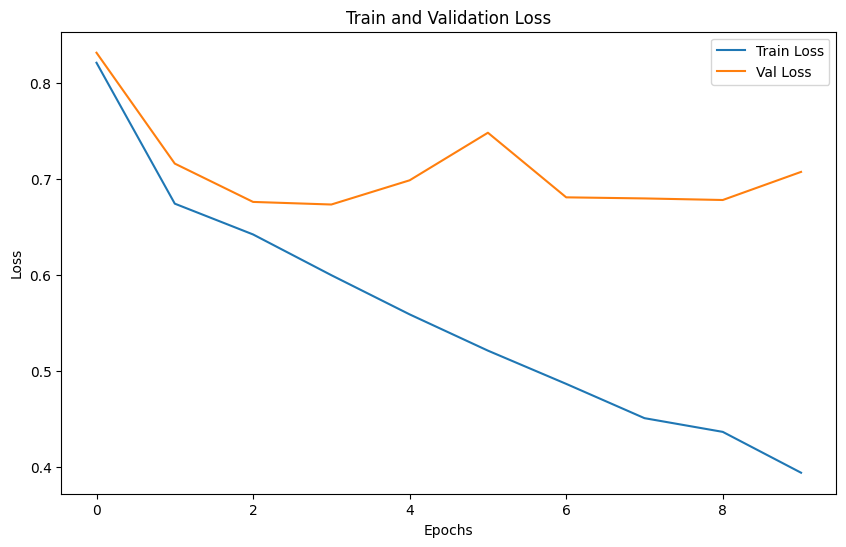

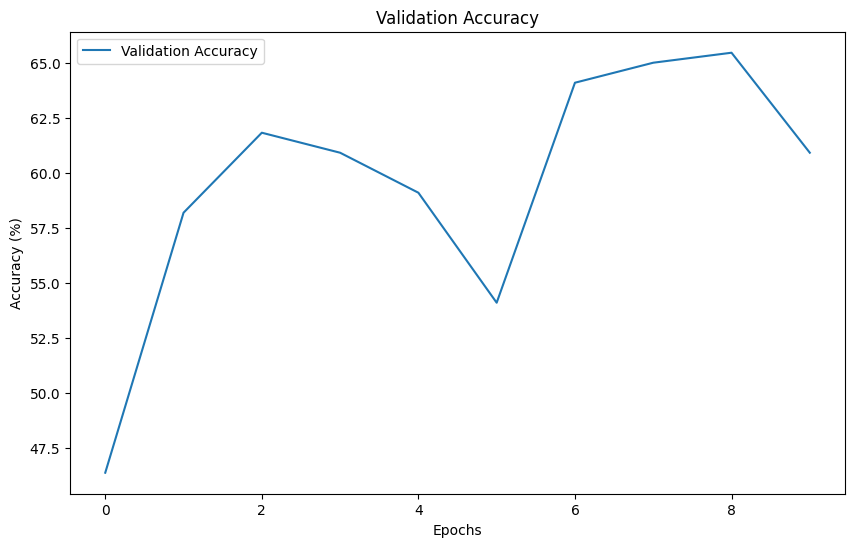

In [ ]:
# Построение графика потерь
plt.figure(figsize=(10, 6))
plt.plot(train_losses, label="Train Loss")
plt.plot(val_losses, label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Train and Validation Loss")
plt.legend()
plt.show()

# График точности
plt.figure(figsize=(10, 6))
plt.plot(val_accuracies, label="Validation Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.title("Validation Accuracy")
plt.legend()
plt.show()

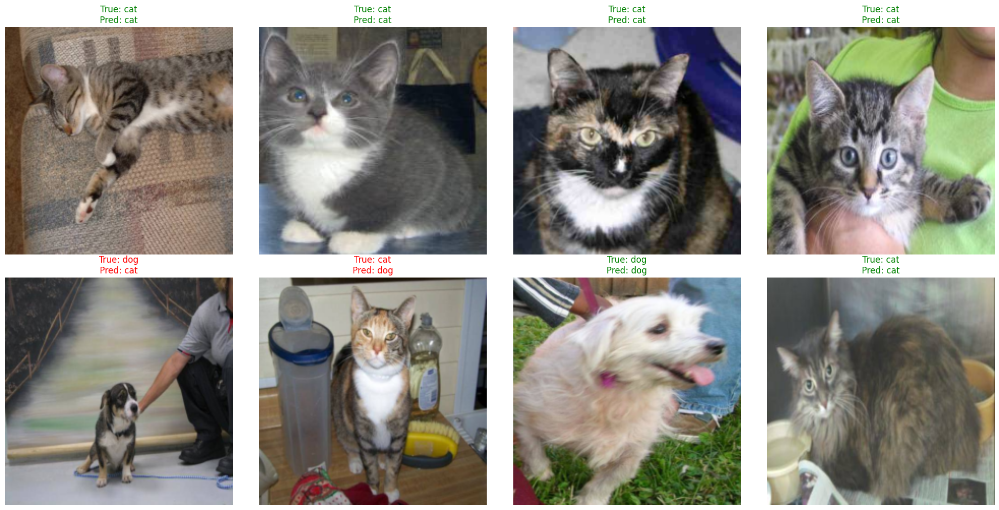

In [ ]:
import matplotlib.pyplot as plt
import torchvision.transforms.functional as F

# Функция для отображения изображений с предсказаниями
def visualize_predictions(model, loader, label_mapping, num_images=8):
    model.eval()
    inv_label_mapping = {v: k for k, v in label_mapping.items()}  # Обратное отображение меток

    imgs, boxes, labels = next(iter(loader))
    imgs = imgs.to("cuda")

    # Истинные метки и предсказания
    true_labels = [inv_label_mapping[label_mapping[label]] for label in labels]
    with torch.no_grad():
        preds_class, preds_bbox = model(imgs)
        _, predicted = torch.max(preds_class, 1)
        predicted_labels = [inv_label_mapping[pred.item()] for pred in predicted]

    # Отображение изображений
    plt.figure(figsize=(20, 10))
    for i in range(min(num_images, len(imgs))):
        img = F.to_pil_image(imgs[i].cpu())
        true_label = true_labels[i]
        pred_label = predicted_labels[i]
        box = boxes["xmin"][i], boxes["ymin"][i], boxes["xmax"][i], boxes["ymax"][i]

        plt.subplot(2, 4, i + 1)
        plt.imshow(img)
        plt.title(f"True: {true_label}\nPred: {pred_label}", color="green" if true_label == pred_label else "red")
        plt.axis("off")

    plt.tight_layout()
    plt.show()

# Вызов функции
visualize_predictions(model, val_loader, label_mapping, num_images=8)

In [ ]:
import matplotlib.pyplot as plt
# Инициализация модели
model = ObjectDetectionModel(num_classes=2).to("cuda")
optimizer = optim.Adam(model.parameters(), lr=1e-4)
criterion_class = nn.CrossEntropyLoss()
criterion_bbox = nn.MSELoss()

# Списки для хранения потерь и точности
train_losses = []
val_losses = []
train_accuracies = []
val_accuracies = []

for epoch in range(10):
    model.train()
    train_loss = 0.0
    correct_train = 0
    total_train = 0

    for imgs, boxes, labels in train_loader:
        # Преобразование данных
        imgs = imgs.to("cuda")
        boxes_tensor = torch.stack(
            [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
            dim=1
        ).to("cuda").float()
        labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

        # Предсказания
        preds_class, preds_bbox = model(imgs)

        # Расчет потерь
        loss_class = criterion_class(preds_class, labels_tensor)
        loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
        loss = loss_class + loss_bbox

        # Обновление весов
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()

        # Расчет точности на тренировочной выборке
        _, predicted = torch.max(preds_class, 1)
        total_train += labels_tensor.size(0)
        correct_train += (predicted == labels_tensor).sum().item()

    # Расчет средней потери и точности на тренировочной выборке
    avg_train_loss = train_loss / len(train_loader)
    train_accuracy = correct_train / total_train * 100

    # Переход в режим оценки для валидационной выборки
    model.eval()
    val_loss = 0.0
    correct_val = 0
    total_val = 0

    with torch.no_grad():
        for imgs, boxes, labels in val_loader:
            # Преобразование данных
            imgs = imgs.to("cuda")
            boxes_tensor = torch.stack(
                [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
                dim=1
            ).to("cuda").float()
            labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

            # Предсказания
            preds_class, preds_bbox = model(imgs)

            # Расчет потерь
            loss_class = criterion_class(preds_class, labels_tensor)
            loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
            loss = loss_class + loss_bbox
            val_loss += loss.item()

            # Расчет точности на валидационной выборке
            _, predicted = torch.max(preds_class, 1)
            total_val += labels_tensor.size(0)
            correct_val += (predicted == labels_tensor).sum().item()

    # Расчет средней потери и точности на валидационной выборке
    avg_val_loss = val_loss / len(val_loader)
    val_accuracy = correct_val / total_val * 100

    # Сохранение метрик
    train_losses.append(avg_train_loss)
    val_losses.append(avg_val_loss)
    train_accuracies.append(train_accuracy)
    val_accuracies.append(val_accuracy)

    print(f"Epoch {epoch+1}: Train Loss: {avg_train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%, "
          f"Val Loss: {avg_val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%")

Epoch 1: Train Loss: 0.7466, Train Accuracy: 53.98%, Val Loss: 0.6988, Val Accuracy: 55.91%
Epoch 2: Train Loss: 0.6629, Train Accuracy: 64.77%, Val Loss: 0.6782, Val Accuracy: 60.00%
Epoch 3: Train Loss: 0.6244, Train Accuracy: 68.86%, Val Loss: 0.6897, Val Accuracy: 55.00%
Epoch 4: Train Loss: 0.5734, Train Accuracy: 73.18%, Val Loss: 0.6708, Val Accuracy: 62.73%
Epoch 5: Train Loss: 0.5225, Train Accuracy: 76.48%, Val Loss: 0.6935, Val Accuracy: 60.45%
Epoch 6: Train Loss: 0.4855, Train Accuracy: 80.68%, Val Loss: 0.7498, Val Accuracy: 51.36%
Epoch 7: Train Loss: 0.4493, Train Accuracy: 82.05%, Val Loss: 0.6922, Val Accuracy: 63.18%
Epoch 8: Train Loss: 0.4112, Train Accuracy: 85.00%, Val Loss: 0.8021, Val Accuracy: 50.00%
Epoch 9: Train Loss: 0.3750, Train Accuracy: 87.73%, Val Loss: 0.7384, Val Accuracy: 60.45%
Epoch 10: Train Loss: 0.3612, Train Accuracy: 87.39%, Val Loss: 0.7768, Val Accuracy: 56.82%


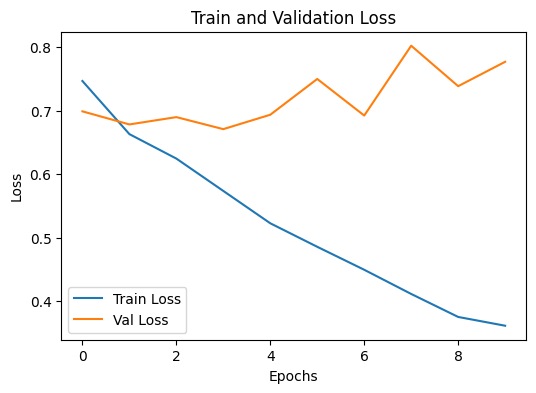

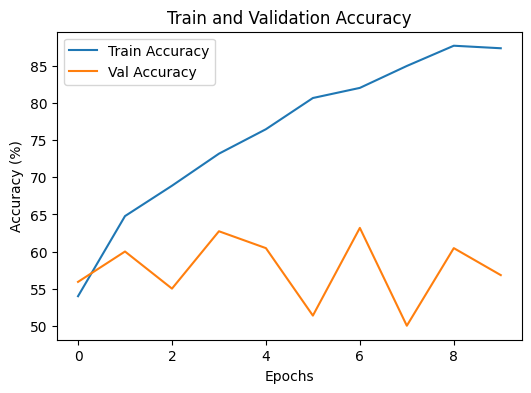

In [ ]:
# Построение графика потерь
plt.figure(figsize=(6, 4))
plt.plot(train_losses, label="Train Loss")
plt.plot(val_losses, label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Train and Validation Loss")
plt.legend()
plt.show()

# Построение графика точности
plt.figure(figsize=(6, 4))
plt.plot(train_accuracies, label="Train Accuracy")
plt.plot(val_accuracies, label="Val Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.title("Train and Validation Accuracy")
plt.legend()
plt.show()

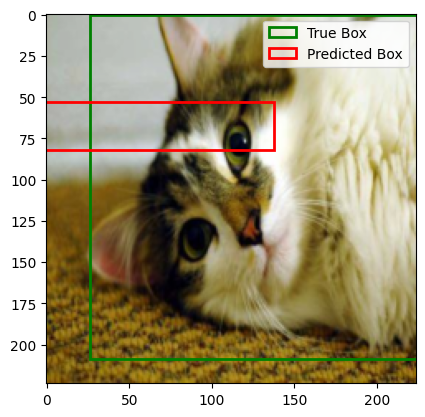

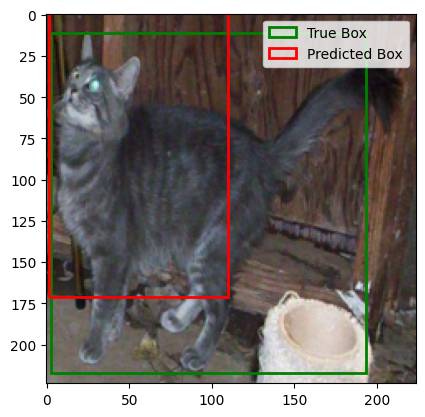

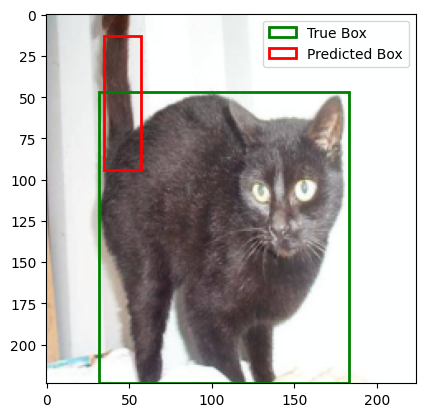

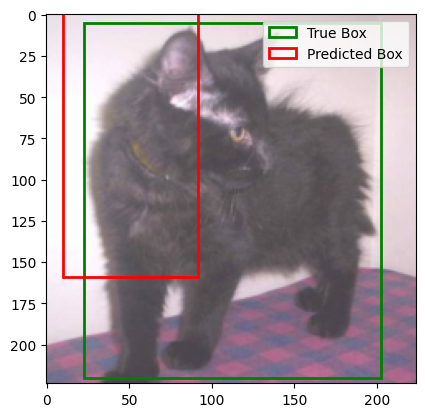

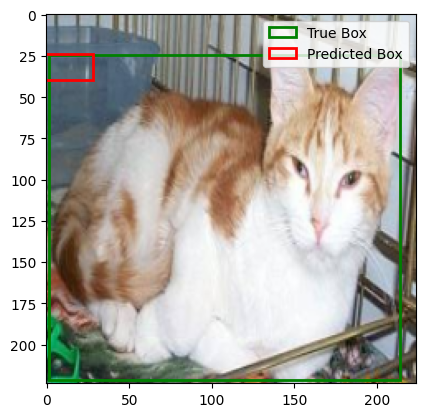

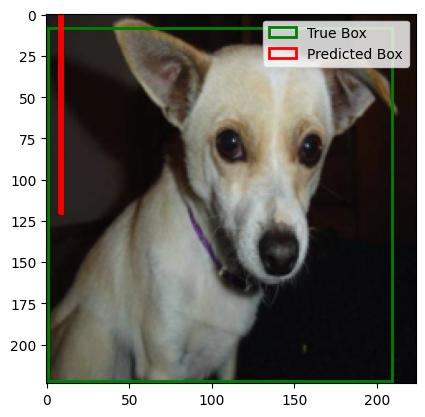

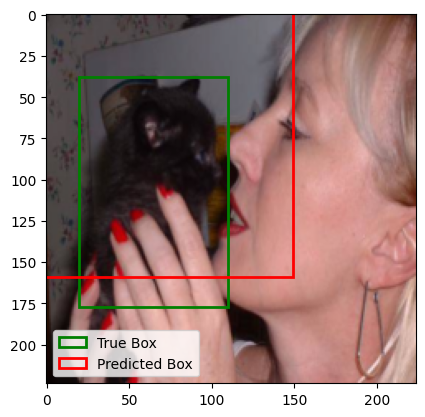

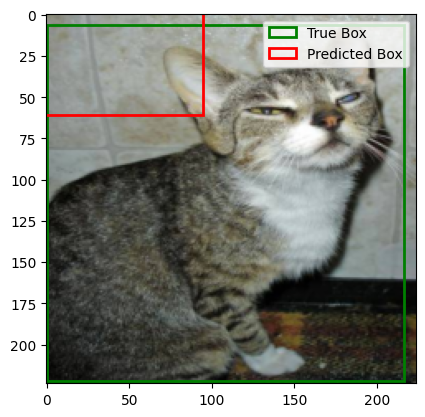

In [ ]:
model.eval()
with torch.no_grad():
    for imgs, boxes, labels in val_loader:
        imgs = imgs.to("cuda")
        preds_class, preds_bbox = model(imgs)

        for i in range(len(imgs)):
            # Извлечение изображения
            img = imgs[i].cpu().permute(1, 2, 0).numpy()
            img = img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]  # Обратная нормализация
            img = img.clip(0, 1)

            # Извлечение размеров изображения
            img_height, img_width = img.shape[:2]

            # Преобразование true_box
            true_box = [
                boxes["xmin"][i].item() * img_width,
                boxes["ymin"][i].item() * img_height,
                boxes["xmax"][i].item() * img_width,
                boxes["ymax"][i].item() * img_height
            ]

            # Преобразование pred_box
            pred_box = [
                preds_bbox[i][0].item() * img_width,
                preds_bbox[i][1].item() * img_height,
                preds_bbox[i][2].item() * img_width,
                preds_bbox[i][3].item() * img_height
            ]

            # Отрисовка
            plt.imshow(img)
            plt.gca().add_patch(plt.Rectangle(
                (true_box[0], true_box[1]),
                true_box[2] - true_box[0],
                true_box[3] - true_box[1],
                edgecolor="green", fill=False, linewidth=2, label="True Box"
            ))
            plt.gca().add_patch(plt.Rectangle(
                (pred_box[0], pred_box[1]),
                pred_box[2] - pred_box[0],
                pred_box[3] - pred_box[1],
                edgecolor="red", fill=False, linewidth=2, label="Predicted Box"
            ))
            plt.legend()
            plt.show()
        break

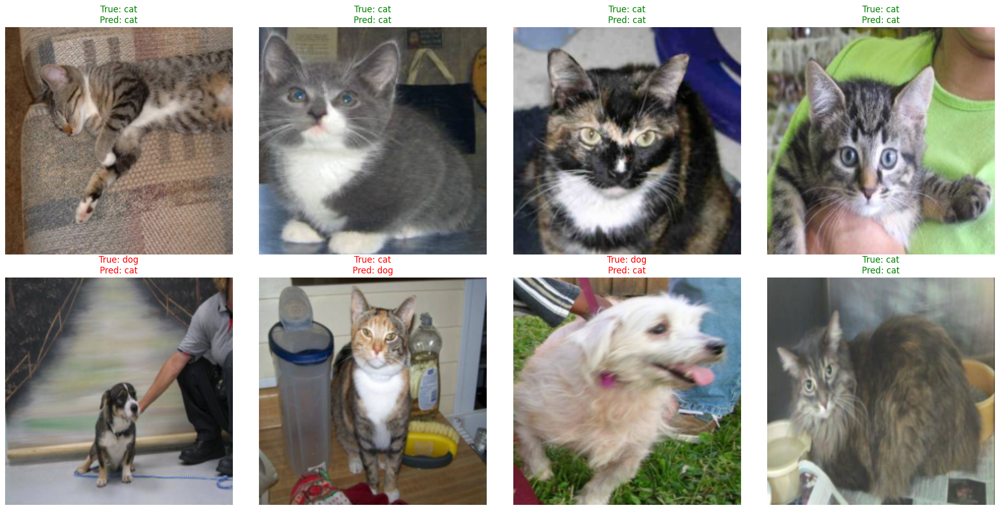

In [ ]:
import matplotlib.pyplot as plt
import torchvision.transforms.functional as F

# Функция для отображения изображений с предсказаниями
def visualize_predictions(model, loader, label_mapping, num_images=8):
    model.eval()
    inv_label_mapping = {v: k for k, v in label_mapping.items()}  # Обратное отображение меток

    imgs, boxes, labels = next(iter(loader))
    imgs = imgs.to("cuda")

    # Истинные метки и предсказания
    true_labels = [inv_label_mapping[label_mapping[label]] for label in labels]
    with torch.no_grad():
        preds_class, preds_bbox = model(imgs)
        _, predicted = torch.max(preds_class, 1)
        predicted_labels = [inv_label_mapping[pred.item()] for pred in predicted]

    # Отображение изображений
    plt.figure(figsize=(20, 10))
    for i in range(min(num_images, len(imgs))):
        img = F.to_pil_image(imgs[i].cpu())
        true_label = true_labels[i]
        pred_label = predicted_labels[i]
        box = boxes["xmin"][i], boxes["ymin"][i], boxes["xmax"][i], boxes["ymax"][i]

        plt.subplot(2, 4, i + 1)
        plt.imshow(img)
        plt.title(f"True: {true_label}\nPred: {pred_label}", color="green" if true_label == pred_label else "red")
        plt.axis("off")

    plt.tight_layout()
    plt.show()

# Вызов функции
visualize_predictions(model, val_loader, label_mapping, num_images=8)

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, random_split
import torchvision.transforms as T
from torchvision.models import resnet50
import matplotlib.pyplot as plt

transforms = T.Compose([
    T.Resize((224, 224)),  # Размер для ResNet
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Нормализация для ResNet
])

dataset = AnimalDetectionDataset("animals.zip", transforms=transforms)

train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8)

class ObjectDetectionModel_N(nn.Module):
    def __init__(self, num_classes):
        super(ObjectDetectionModel_N, self).__init__()
        # Используем ResNet50 в качестве backbone
        backbone = resnet50(weights='IMAGENET1K_V1')  # Подходит для torch >= 0.13.0
        self.backbone = nn.Sequential(*list(backbone.children())[:-2])  # Убираем последний слой классификации
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))  # Pooling для уменьшения размерности
        self.freeze_backbone()  # Заморозка backbone для ускорения обучения

        # Две "головы"
        self.fc_class = nn.Linear(2048, num_classes)  # Классификация (кол-во классов)
        self.fc_bbox = nn.Linear(2048, 4)  # Регрессия (координаты bbox)

    def freeze_backbone(self):
        """Заморозка слоев backbone для ускорения обучения."""
        for param in self.backbone.parameters():
            param.requires_grad = False

    def forward(self, x):
        # Прогон через backbone
        x = self.backbone(x)
        x = self.avgpool(x)
        x = torch.flatten(x, 1)  # Преобразование к [batch_size, features]

        # Две головы
        class_output = self.fc_class(x)  # Предсказания класса
        bbox_output = self.fc_bbox(x)  # Координаты bbox
        return class_output, bbox_output

#model = ObjectDetectionModel(num_classes=2).to("cuda")

In [ ]:
model = ObjectDetectionModel_N(num_classes=2).to("cuda")

optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4)
criterion_class = nn.CrossEntropyLoss()
criterion_bbox = nn.MSELoss()

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []

label_mapping = {'cat': 0, 'dog': 1}

for epoch in range(10):
    model.train()
    train_loss, correct_train, total_train = 0.0, 0, 0

    for imgs, boxes, labels in train_loader:
        imgs = imgs.to("cuda")
        boxes_tensor = torch.stack(
            [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
            dim=1
        ).to("cuda").float()
        labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

        preds_class, preds_bbox = model(imgs)
        loss_class = criterion_class(preds_class, labels_tensor)
        loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
        loss = loss_class + loss_bbox

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        _, predicted = torch.max(preds_class, 1)
        total_train += labels_tensor.size(0)
        correct_train += (predicted == labels_tensor).sum().item()

    train_losses.append(train_loss / len(train_loader))
    train_accuracies.append(correct_train / total_train * 100)

    model.eval()
    val_loss, correct_val, total_val = 0.0, 0, 0
    with torch.no_grad():
        for imgs, boxes, labels in val_loader:
            imgs = imgs.to("cuda")
            boxes_tensor = torch.stack(
                [boxes["xmin"], boxes["ymin"], boxes["xmax"], boxes["ymax"]],
                dim=1
            ).to("cuda").float()
            labels_tensor = torch.tensor([label_mapping[label] for label in labels]).to("cuda")

            preds_class, preds_bbox = model(imgs)
            loss_class = criterion_class(preds_class, labels_tensor)
            loss_bbox = criterion_bbox(preds_bbox, boxes_tensor)
            val_loss += loss_class.item() + loss_bbox.item()

            _, predicted = torch.max(preds_class, 1)
            total_val += labels_tensor.size(0)
            correct_val += (predicted == labels_tensor).sum().item()

    val_losses.append(val_loss / len(val_loader))
    val_accuracies.append(correct_val / total_val * 100)

    print(f"Epoch {epoch+1}: Train Loss: {train_losses[-1]:.4f}, Train Accuracy: {train_accuracies[-1]:.2f}%, "
          f"Val Loss: {val_losses[-1]:.4f}, Val Accuracy: {val_accuracies[-1]:.2f}%")

Epoch 1: Train Loss: 0.5574, Train Accuracy: 83.98%, Val Loss: 0.3901, Val Accuracy: 92.73%
Epoch 2: Train Loss: 0.3647, Train Accuracy: 91.36%, Val Loss: 0.2815, Val Accuracy: 95.00%
Epoch 3: Train Loss: 0.2803, Train Accuracy: 92.95%, Val Loss: 0.2377, Val Accuracy: 94.09%
Epoch 4: Train Loss: 0.2484, Train Accuracy: 93.30%, Val Loss: 0.2028, Val Accuracy: 94.55%
Epoch 5: Train Loss: 0.2254, Train Accuracy: 93.98%, Val Loss: 0.1788, Val Accuracy: 95.00%
Epoch 6: Train Loss: 0.2061, Train Accuracy: 94.32%, Val Loss: 0.1674, Val Accuracy: 95.00%
Epoch 7: Train Loss: 0.2031, Train Accuracy: 94.77%, Val Loss: 0.1539, Val Accuracy: 95.00%
Epoch 8: Train Loss: 0.1887, Train Accuracy: 94.66%, Val Loss: 0.1432, Val Accuracy: 95.45%
Epoch 9: Train Loss: 0.1818, Train Accuracy: 93.86%, Val Loss: 0.1440, Val Accuracy: 95.91%
Epoch 10: Train Loss: 0.1721, Train Accuracy: 94.66%, Val Loss: 0.1384, Val Accuracy: 95.91%


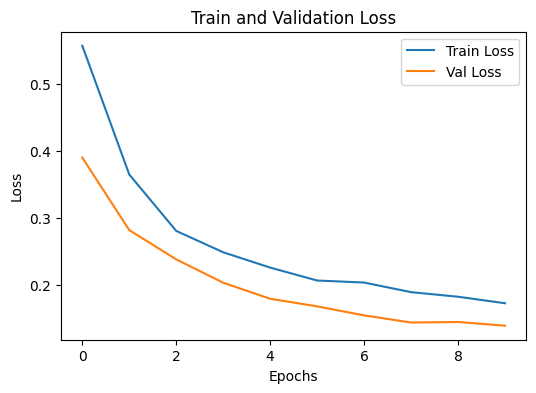

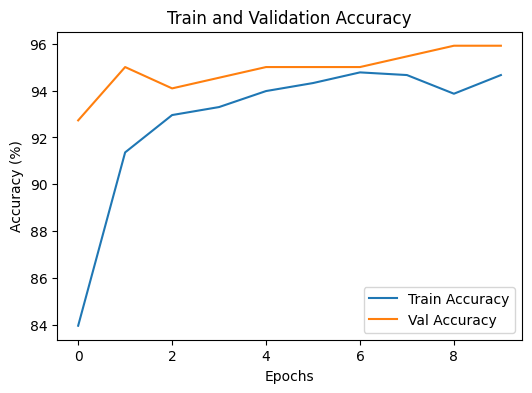

In [ ]:
plt.figure(figsize=(6, 4))
plt.plot(train_losses, label="Train Loss")
plt.plot(val_losses, label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Train and Validation Loss")
plt.legend()
plt.show()

plt.figure(figsize=(6, 4))
plt.plot(train_accuracies, label="Train Accuracy")
plt.plot(val_accuracies, label="Val Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.title("Train and Validation Accuracy")
plt.legend()
plt.show()

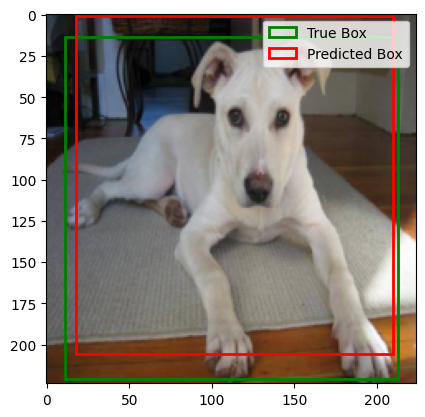

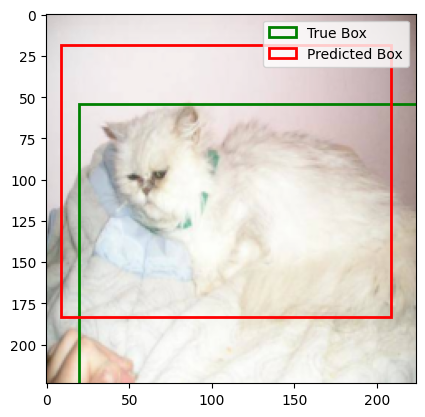

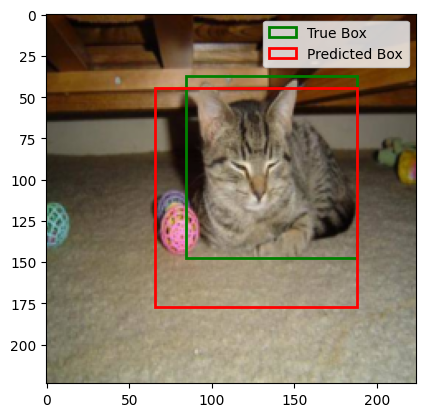

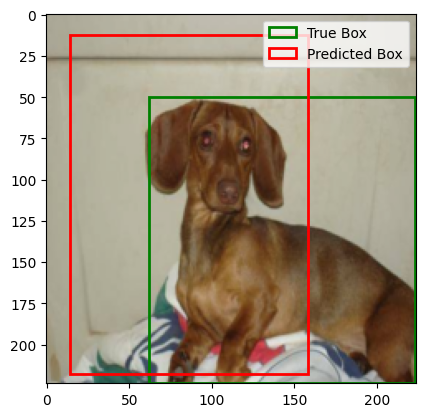

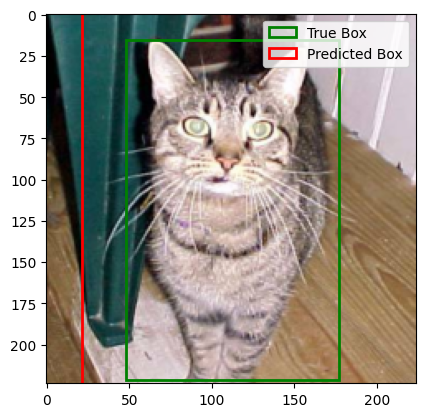

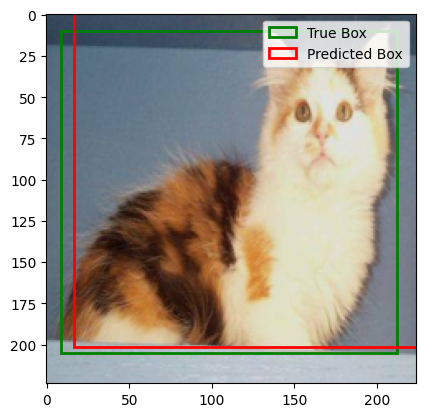

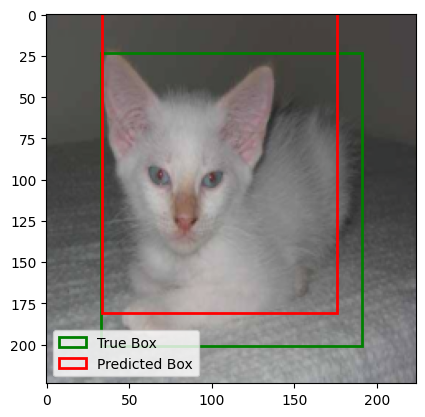

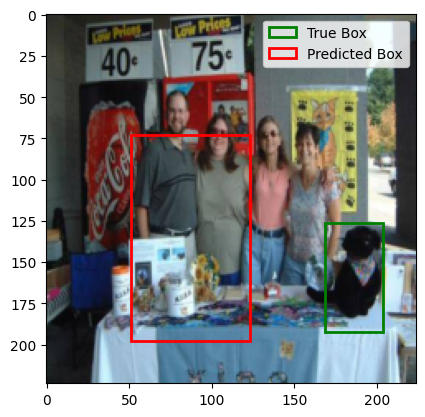

In [ ]:
model.eval()
with torch.no_grad():
    for imgs, boxes, labels in val_loader:
        imgs = imgs.to("cuda")
        preds_class, preds_bbox = model(imgs)

        for i in range(len(imgs)):
            # Извлечение изображения
            img = imgs[i].cpu().permute(1, 2, 0).numpy()
            img = img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]  # Обратная нормализация
            img = img.clip(0, 1)

            # Извлечение размеров изображения
            img_height, img_width = img.shape[:2]

            # Преобразование true_box
            true_box = [
                boxes["xmin"][i].item() * img_width,
                boxes["ymin"][i].item() * img_height,
                boxes["xmax"][i].item() * img_width,
                boxes["ymax"][i].item() * img_height
            ]

            # Преобразование pred_box
            pred_box = [
                preds_bbox[i][0].item() * img_width,
                preds_bbox[i][1].item() * img_height,
                preds_bbox[i][2].item() * img_width,
                preds_bbox[i][3].item() * img_height
            ]

            # Отрисовка
            plt.imshow(img)
            plt.gca().add_patch(plt.Rectangle(
                (true_box[0], true_box[1]),
                true_box[2] - true_box[0],
                true_box[3] - true_box[1],
                edgecolor="green", fill=False, linewidth=2, label="True Box"
            ))
            plt.gca().add_patch(plt.Rectangle(
                (pred_box[0], pred_box[1]),
                pred_box[2] - pred_box[0],
                pred_box[3] - pred_box[1],
                edgecolor="red", fill=False, linewidth=2, label="Predicted Box"
            ))
            plt.legend()
            plt.show()
        break

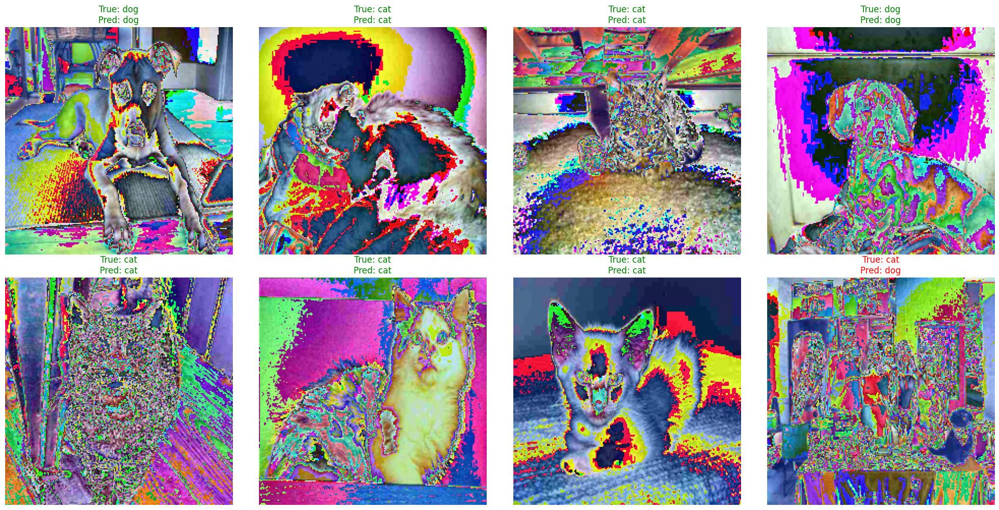

In [ ]:
import matplotlib.pyplot as plt
import torchvision.transforms.functional as F

def visualize_predictions(model, loader, label_mapping, num_images=8):
    model.eval()
    inv_label_mapping = {v: k for k, v in label_mapping.items()}  # Обратное отображение меток

    imgs, boxes, labels = next(iter(loader))
    imgs = imgs.to("cuda")

    # Истинные метки и предсказания
    true_labels = [inv_label_mapping[label_mapping[label]] for label in labels]
    with torch.no_grad():
        preds_class, preds_bbox = model(imgs)
        _, predicted = torch.max(preds_class, 1)
        predicted_labels = [inv_label_mapping[pred.item()] for pred in predicted]

    # Отображение изображений
    plt.figure(figsize=(20, 10))
    for i in range(min(num_images, len(imgs))):
        img = F.to_pil_image(imgs[i].cpu())
        true_label = true_labels[i]
        pred_label = predicted_labels[i]
        box = boxes["xmin"][i], boxes["ymin"][i], boxes["xmax"][i], boxes["ymax"][i]

        plt.subplot(2, 4, i + 1)
        plt.imshow(img)
        plt.title(f"True: {true_label}\nPred: {pred_label}", color="green" if true_label == pred_label else "red")
        plt.axis("off")

    plt.tight_layout()
    plt.show()

# Вызов функции
visualize_predictions(model, val_loader, label_mapping, num_images=8)

## Обратная связь
- [ ] Хочу получить обратную связь по решению